<a href="https://colab.research.google.com/github/katL7/GTSRB-APS360/blob/AE/APS360_AE_Traffic_Sign_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Imports

In [ ]:
import numpy as np
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms
from torch.utils.data.sampler import SubsetRandomSampler
from google.colab import drive
import os
import matplotlib.pyplot as plt
import random

In [ ]:
use_cuda = True

## Dataset loaders

In [ ]:
# split into training, validation and test - stratify each
def get_val_test_loader(batch_size=64, img_size=50):
    # Rescale images to all be the same size
    data_transform = transforms.Compose([transforms.Resize((img_size,img_size)), 
                                         transforms.ToTensor()])

    # Get paths to data in folder
    gtsrb_data = datasets.GTSRB('data', download=True, split='test',
                           transform=data_transform)

    class_idxs = {}
    #Loop through filenames and sort into classes
    for i, data in enumerate(gtsrb_data):
        img, label = data
        if label in class_idxs:
          class_idxs[label].append(i)
        else:
          class_idxs[label] = [i]

    np.random.seed(1000)
    test_indices = []
    val_indices = []

    for class_key in class_idxs:
      #Split validation/testing indices as 0.7/0.3 split by class
      np.random.shuffle(class_idxs[class_key])
      split = int(len(class_idxs[class_key]) * 0.7)
      val_indices += class_idxs[class_key][:split]
      test_indices += class_idxs[class_key][split:]

    #Shuffle the testing/validation indices
    np.random.shuffle(test_indices)
    np.random.shuffle(val_indices)

    #testing data loader
    test_sampler = SubsetRandomSampler(test_indices)
    test_loader = torch.utils.data.DataLoader(gtsrb_data, batch_size=batch_size,
          num_workers=0, sampler=test_sampler)

    #Validation data loader
    val_sampler = SubsetRandomSampler(val_indices)
    val_loader = torch.utils.data.DataLoader(gtsrb_data, batch_size=batch_size,
          num_workers=0, sampler=val_sampler)
    
    return val_loader, test_loader

In [ ]:
def get_train_loader(batch_size=64, img_size=50):
    # Rescale images to all be the same size
    data_transform = transforms.Compose([transforms.Resize((img_size,img_size)), 
                                         transforms.ToTensor()])

    # Get paths to data in folder
    data = datasets.GTSRB('data', download=True, split="train",
                          transform=data_transform)
  
    np.random.seed(1000)
    #train data loader
    train_loader = torch.utils.data.DataLoader(data, batch_size=batch_size,
          num_workers=0, shuffle=True)
    
    return train_loader



In [ ]:
val_loader, test_loader = get_val_test_loader(64)

In [ ]:

train_loader = get_train_loader(64)

In [ ]:
# Label Overview
classes = { 0:'Speed limit (20km/h)',
            1:'Speed limit (30km/h)', 
            2:'Speed limit (50km/h)', 
            3:'Speed limit (60km/h)', 
            4:'Speed limit (70km/h)', 
            5:'Speed limit (80km/h)', 
            6:'End of speed limit (80km/h)', 
            7:'Speed limit (100km/h)', 
            8:'Speed limit (120km/h)', 
            9:'No passing', 
            10:'No passing veh over 3.5 tons', 
            11:'Right-of-way at intersection', 
            12:'Priority road', 
            13:'Yield', 
            14:'Stop', 
            15:'No vehicles', 
            16:'Veh > 3.5 tons prohibited', 
            17:'No entry', 
            18:'General caution', 
            19:'Dangerous curve left', 
            20:'Dangerous curve right', 
            21:'Double curve', 
            22:'Bumpy road', 
            23:'Slippery road', 
            24:'Road narrows on the right', 
            25:'Road work', 
            26:'Traffic signals', 
            27:'Pedestrians', 
            28:'Children crossing', 
            29:'Bicycles crossing', 
            30:'Beware of ice/snow',
            31:'Wild animals crossing', 
            32:'End speed + passing limits', 
            33:'Turn right ahead', 
            34:'Turn left ahead', 
            35:'Ahead only', 
            36:'Go straight or right', 
            37:'Go straight or left', 
            38:'Keep right', 
            39:'Keep left', 
            40:'Roundabout mandatory', 
            41:'End of no passing', 
            42:'End no passing veh > 3.5 tons' }

# Initial model - CNN

First I'm gonna try my own CNN since AlexNet was trained on 224x224 and our images are a lot smaller (not sure if this matters)

In [ ]:
class TrafficSignModel(nn.Module):
  def __init__(self):
     super(TrafficSignModel, self).__init__()
     self.name = "TrafficSignModel"
     self.conv1 = nn.Conv2d(3, 5, 5) # 3 input channels, 5 output channels, kernel size of 5
     self.pool = nn.MaxPool2d(2, 2) # kernel size of 2, stride of 2
     self.conv2 = nn.Conv2d(5, 10, 5) # 5 input channels, 10 output channels, kernel size of 5
     self.fc1 = nn.Linear(10 * 9 * 9, 28) # 10 input channels, 12*12 input dimension, output to 28 channels
     self.fc2 = nn.Linear(28, 43) # 28 channels to 43 channels for classification
         
  def forward(self, x):
    x = self.pool(F.relu(self.conv1(x)))
    x = self.pool(F.relu(self.conv2(x)))
    x = x.view(-1, 10 * 9 * 9) # Flatten image
    x = F.relu(self.fc1(x))
    x = self.fc2(x)
    x = x.squeeze(1) # Flatten to [batch_size]
    return x

Train the network

In [ ]:
# Function to obtain accuracy
def get_accuracy(net, data_loader):
  correct = 0
  total = 0

  for imgs, labels in data_loader:
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
      labels = labels.cuda()
    #############################################
    output = net(imgs)
    prediction = output.max(1, keepdim=True)[1]
    correct += prediction.eq(labels.view_as(prediction)).sum().item()
    total += imgs.shape[0]
  return correct / total

In [ ]:
# Function to obtain error
def get_error(net, data_loader):
  correct = 0
  total = 0
  evaluate_net = net.eval()

  for imgs, labels in data_loader:
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
      labels = labels.cuda()
    #############################################
    output = evaluate_net(imgs)
    prediction = output.max(1, keepdim=True)[1]
    correct += prediction.eq(labels.view_as(prediction)).sum().item()
    total += imgs.shape[0]
  return (total - correct) / total

In [ ]:
# Function to obtain loss
def get_loss(net, data_loader, criterion):
  loss = 0.0
  total_loss = 0.0
  evaluate_net = net.eval()
  for imgs, labels in data_loader:
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
      labels = labels.cuda()
    #############################################
    output = evaluate_net(imgs)
    loss = criterion(output, labels)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader))
  return loss

In [ ]:
# Function to get model name
def get_model_name(name, batch_size, learning_rate, epoch):
    """ Generate a name for the model consisting of all the hyperparameter values

    Args:
        config: Configuration object containing the hyperparameters
    Returns:
        path: A string with the hyperparameter name and value concatenated
    """
    path = "model_{0}_bs{1}_lr{2}_epoch{3}".format(name,
                                                   batch_size,
                                                   learning_rate,
                                                   epoch)
    return path

In [ ]:
# Function to plot Training Curve
def plot_training_curve(path):
    """ Plots the training curve for a model run, given the csv files
    containing the train/validation error/loss.

    Args:
        path: The base path of the csv files produced during training
    """
    import matplotlib.pyplot as plt
    train_err = np.loadtxt("{}_train_err.csv".format(path))
    val_err = np.loadtxt("{}_val_err.csv".format(path))
    train_loss = np.loadtxt("{}_train_loss.csv".format(path))
    val_loss = np.loadtxt("{}_val_loss.csv".format(path))
    plt.title("Train vs Validation Error")
    n = len(train_err) # number of epochs
    plt.plot(range(1,n+1), train_err, label="Train")
    plt.plot(range(1,n+1), val_err, label="Validation")
    plt.xlabel("Epoch")
    plt.ylabel("Error")
    plt.legend(loc='best')
    plt.show()
    plt.title("Train vs Validation Loss")
    plt.plot(range(1,n+1), train_loss, label="Train")
    plt.plot(range(1,n+1), val_loss, label="Validation")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend(loc='best')
    plt.show()

In [ ]:
def train_net(net, train_loader, val_loader, batch_size=64, learning_rate=0.01, num_epochs=30):
  # Set the seed for reproducible results
  torch.manual_seed(1000)

  # Define the loss function - we will use Cross Entropy Loss for this classification problem
  criterion = nn.CrossEntropyLoss()

  # Define the optimizer -  we will use Adaptive moment estimation
  optimizer = optim.Adam(net.parameters(), lr = learning_rate)

  # Arrays to store stats
  train_err = np.zeros(num_epochs)
  train_loss = np.zeros(num_epochs)
  val_err = np.zeros(num_epochs)
  val_loss = np.zeros(num_epochs)

  n = 0 # number iterations
  for epoch in range(num_epochs):
    total_train_loss = 0.0
    for imgs, labels in train_loader:
      #############################################
      #To Enable GPU Usage
      if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
      #############################################
      out = net(imgs)                 # forward passs
      loss = criterion(out, labels)   # compute loss
      loss.backward()                 # backward pass
      optimizer.step()                # update paramters
      optimizer.zero_grad()           # clean up

      total_train_loss += loss.item()

    train_err[epoch] = get_error(net, train_loader)
    train_loss[epoch] = float(total_train_loss) / (len(train_loader))
    val_err[epoch] = get_error(net, val_loader)
    val_loss[epoch] = get_loss(net, val_loader, criterion)

    print(("Epoch {}: Train error: {}, Train loss: {}, Val error: {}, Val loss: {}").format(
        epoch +1,
        train_err[epoch],
        train_loss[epoch],
        val_err[epoch],
        val_loss[epoch]))
    
    # Save the current model after each epoch
    model_path = get_model_name(net.name, batch_size, learning_rate, epoch)
    torch.save(net.state_dict(), model_path)

  # Finished training, save statistics to CSV
  epochs = np.arange(1, num_epochs + 1)
  np.savetxt("{}_train_err.csv".format(model_path), train_err)
  np.savetxt("{}_train_loss.csv".format(model_path), val_err)
  np.savetxt("{}_val_loss.csv".format(model_path), val_loss)

  # plotting
  plot_training_curve(model_path)


### Try to overfit the data

In [ ]:
def get_debug_loader():
  # Rescale images to all be the same size
  data_transform = transforms.Compose([transforms.Resize((50,50)), 
                                       transforms.ToTensor()])

  # Get paths to data in folder
  debug_data = datasets.GTSRB('data', download=True, split="train",
                        transform=data_transform)
  #print(len(debug_data))
  debug_data = list(debug_data)
  debug_data = debug_data[:64]
  #print(len(debug_data))

  np.random.seed(1000)
  debug_loader = torch.utils.data.DataLoader(debug_data, batch_size=64,
        num_workers=0, shuffle=True)
  return debug_loader


In [ ]:
overfit_loader = get_debug_loader()
model = TrafficSignModel()

if use_cuda and torch.cuda.is_available():
  model.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

train_net(model, train_loader, val_loader, batch_size=256, learning_rate=0.1, num_epochs=30)

CUDA is available!  Training on GPU ...
Epoch 1: Train error: 0.9436936936936937, Train loss: 4.024146261832697, Val error: 0.9405166553365057, Val loss: 3.4755701241285903
Epoch 2: Train error: 0.9459459459459459, Train loss: 3.51678496927952, Val error: 0.9430092907319284, Val loss: 3.4743998223456782
Epoch 3: Train error: 0.9504504504504504, Train loss: 3.514357092855074, Val error: 0.9477679583050079, Val loss: 3.4764895732851997


KeyboardInterrupt: ignored

# Model using AlexNet Features

In [ ]:
# link to your Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#### Update this to the correct path to the alexnet features folder ####
PATH_TO_FEATURES = '/content/drive/MyDrive/AlexNet_Features/'

In [ ]:
# Save Alexnet features
#### Do not re-run, this takes ages. Instead use the google drive. ####
# import torchvision.models
# alexnet = torchvision.models.alexnet(pretrained=True)

# feature_train_loader = []
# feature_val_loader = []
# feature_test_loader = []


# val_loader, test_loader = get_val_test_loader(batch_size=1, img_size=256)
# train_loader = get_train_loader(batch_size=1, img_size=256)
# data_dir = 'drive/MyDrive/APS360/Project/AlexNet_Features/'

# i=0
# for image, label in train_loader:
#   feature = alexnet.features(image)
#   torch.save(feature[0], data_dir+"Train_Features/"+str(label.item())+"/train_feature_"+str(i)+".pt")
#   i +=1

# for image, label in val_loader:
#   feature = alexnet.features(image)
#   torch.save(feature[0], data_dir+"Val_Features/"+str(label.item())+"/val_feature_"+str(i)+".pt")
#   i +=1
# for image, label in test_loader:
#   feature = alexnet.features(image)
#   torch.save(feature[0], data_dir+"Test_Features/"+str(label.item())+"/test_feature_"+str(i)+".pt")
#   i +=1


In [ ]:
class TrafficSignModelFeatures(nn.Module):
  def __init__(self):
    super(TrafficSignModelFeatures, self).__init__()
    self.name = "TrafficSignModelFeatures"
    self.conv1 = nn.Conv2d(256, 280, 3)
    self.fc1 = nn.Linear(280 * 5 * 5, 80) #tried 40 but 32 gave better results
    self.fc2 = nn.Linear(80, 43) 

  def forward(self, x):
    x = F.relu(self.conv1(x))
    x = x.view(-1, 280 * 5 * 5)
    x = F.relu(self.fc1(x))
    x = self.fc2(x)
    x = x.squeeze(1) # Flatten to [batch_size]
    return x

In [ ]:
def get_data_loader_features(batch_size=64):
    """ Loads features from google drive folder. Returns data loaders for the 
    three preprocessed datasets.

    Args:
        batch_size: A int representing the number of samples per batch
    
    Returns:
        train_loader: iterable training dataset organized according to batch size
        val_loader: iterable validation dataset organized according to batch size
        test_loader: iterable testing dataset organized according to batch size
    """

    transform = lambda t: torch.from_numpy(t.detach().numpy())

    #Get paths to data in folder
    data_dir = PATH_TO_FEATURES #define above
    train_data = torchvision.datasets.DatasetFolder(
        data_dir+"Train_Features/", torch.load, extensions = [".pt"], transform=transform)
    val_data = torchvision.datasets.DatasetFolder(
        data_dir+"Val_Features/", torch.load, extensions = [".pt"], transform=transform)
    test_data = torchvision.datasets.DatasetFolder(
        data_dir+"Test_Features/", torch.load, extensions = [".pt"], transform=transform)

    #Training data loader
    train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
          num_workers=0, shuffle=True)

    #Validation data loader
    val_loader = torch.utils.data.DataLoader(val_data, batch_size=batch_size,
          num_workers=0, shuffle=True)

    #Test data loader
    test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size,
          num_workers=0, shuffle=True)
    
    return train_loader, val_loader, test_loader


In [ ]:
model = TrafficSignModelFeatures()
use_cuda = True

if use_cuda and torch.cuda.is_available():
  model.cuda()
  print('CUDA is available!  Training on GPU ...')
else:
  print('CUDA is not available.  Training on CPU ...')

train_loader, val_loader, test_loader = get_data_loader_features(512)

train_net(model, train_loader, val_loader, batch_size=512, learning_rate=0.006, num_epochs=10)

CUDA is available!  Training on GPU ...


KeyboardInterrupt: ignored

Some hacky code to get graphs because the model training code cell broke when trying to graph and I (Katherine) didn't want to re-train the whole thing

Text(0, 0.5, 'Error')

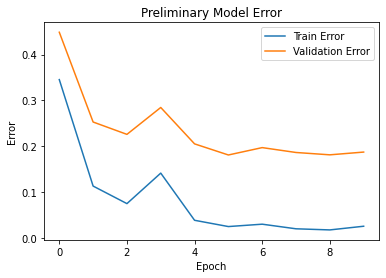

In [ ]:
train_error = [
    0.3454204204204204,
    0.1131006006006006,
    0.0748123123123123,
    0.14136636636636637,
    0.03843843843843844,
    0.024737237237237236,
    0.02991741741741742,
    0.019857357357357358,
    0.017417417417417418,
    0.02545045045045045
]

train_loss = [
    1.9975641099911816,
    0.519983450196824,
    0.2568095434667929,
    0.1846058669517625,
    0.2003081373448642,
    0.10167069979152589, 
    0.07658512932511996,
    0.06751177927373715,
    0.06092002173393683,
    0.048539706382830186,
]
val_error = [
    0.4487876727849536,
    0.2528891910265126,
    0.2259234081123952,
    0.2846136415137095,
    0.20518921368683435,
    0.18094266938590528,
    0.19703149784726942,
    0.1863811466122819,
    0.1812825742125538,
    0.18728755948334466,
]

val_loss = [
    1.789199047618442,
    0.9529184301694235,
    0.8560722205373976,
    1.2405276364750333,
    0.8659322228696611,
    0.8551405800713433,
    0.9747237728701698,
    0.9954167770014869,
    1.0150667329629262,
    1.056118968460295

]

plt.plot(list(range(10)),train_error)
plt.plot(list(range(10)),val_error)
plt.legend(["Train Error", "Validation Error"])

plt.title("Preliminary Model Error")
plt.xlabel("Epoch")
plt.ylabel("Error")

Text(0, 0.5, 'Loss')

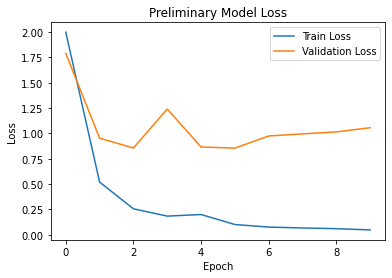

In [ ]:
plt.plot(list(range(10)),train_loss)
plt.plot(list(range(10)),val_loss)
plt.legend(["Train Loss", "Validation Loss"])

plt.title("Preliminary Model Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")

In [ ]:
model_path = get_model_name("TrafficSignModelFeatures", 512, 0.006, 9)
plot_training_curve(model_path)


OSError: ignored

## Jordan just playing around to try to get a dataloader object
I'm using Lab 2 as a guide

Figuring out the structure of the dataset

In [ ]:
print(type(gtsrb_data))
print(gtsrb_data)
print(len(gtsrb_data))
print(gtsrb_data[10000][1])

Using some helper functions that I've slightly modified from Lab 2

In [ ]:
def get_relevant_indices(dataset, classes, target_classes):
    """ Return the indices for datapoints in the dataset that belongs to the
    desired target classes, a subset of all possible classes.

    Args:
        dataset: Dataset object
        classes: A list of strings denoting the name of each class
        target_classes: A list of strings denoting the name of desired classes
                        Should be a subset of the 'classes'
    Returns:
        indices: list of indices that have labels corresponding to one of the
                 target classes
    """
    indices = []
    for i in range(len(dataset)):
        # Check if the label is in the target classes
        label_index = dataset[i][1] # ex: 3
        # label_class = classes[label_index] # ex: 'cat'
        if label_index in target_classes:
            indices.append(i)
    return indices

def get_data_loader(target_classes, batch_size):
    """ Loads images of signs, splits the data into training, validation
    and testing datasets. Returns data loaders for the three preprocessed datasets.

    Args:
        target_classes: A list of ints denoting the index of the desired
                        classes. Should be a subset of the argument 'classes'
        batch_size: A int representing the number of samples per batch
    
    Returns:
        train_loader: iterable training dataset organized according to batch size
        val_loader: iterable validation dataset organized according to batch size
        test_loader: iterable testing dataset organized according to batch size
        classes: A list of ints denoting the index of each class
    """

    classes = tuple(range(0,43))
    ########################################################################
    # The output of torchvision datasets are PILImage images of range [0, 1].
    # We transform them to Tensors of normalized range [-1, 1].
    transform = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
    # Load GTSRB training data
    trainset = torchvision.datasets.GTSRB(root='./data', split='train', transform=transform, download=True)
    # Get the list of indices to sample from
    relevant_indices = get_relevant_indices(trainset, classes, target_classes)
    
    # Split into train and validation
    np.random.seed(1000) # Fixed numpy random seed for reproducible shuffling
    np.random.shuffle(relevant_indices)
    split = int(len(relevant_indices) * 0.8) #split at 80%
    
    # split into training and validation indices
    relevant_train_indices, relevant_val_indices = relevant_indices[:split], relevant_indices[split:]  
    train_sampler = SubsetRandomSampler(relevant_train_indices)
    train_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                               num_workers=1, sampler=train_sampler)
    val_sampler = SubsetRandomSampler(relevant_val_indices)
    val_loader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                              num_workers=1, sampler=val_sampler)
    # Load GTSRB testing data
    testset = torchvision.datasets.GTSRB(root='./data', split='test', transform=transform, download=True)
    # Get the list of indices to sample from
    relevant_test_indices = get_relevant_indices(testset, classes, target_classes)
    test_sampler = SubsetRandomSampler(relevant_test_indices)
    test_loader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                             num_workers=1, sampler=test_sampler)
    return train_loader, val_loader, test_loader, classes

In [ ]:
classes = tuple(range(0,43))
target_classes = (0,)
print(type(classes[0]))
print(classes)
indices_class_0 = get_relevant_indices(gtsrb_data, classes, target_classes)
print(indices_class_0) # Now I have the indices in gtsrb_data of ClassId=0

# Get data loaders for training, validation, and test sets (images are only of ClassId=0)
train_loader, val_loader, test_loader, classes = get_data_loader(target_classes, batch_size=5)

In [ ]:
# Playing around with data loaders I created above
print(len(train_loader)) # There are 24 batches (5 images/batch) in the train loader -> This is 120 images which is 80% of 150!
print(len(val_loader)) # There are 6 batches (5 images/batch) in the val loader -> This is 30 images which is 20% of 150
print(len(test_loader)) # There are 12 batches (5 images/batch) in the test loader -> This is 60 images

Next I'll try to plot some of the images, just to see what we're working with

I don't think this is working because the images are of different sizes, we'll have to figure out what we're doing about this.

In [ ]:
k = 0
for images, labels in enumerate(train_loader):
    # since batch_size = 5, there are 5 images in 'images'
    for i in range(0,5):
      image = images[i]
      # place the colour channel at the end, instead of at the beginning
      img = np.transpose(image, [1,2,0])
      # normalize pixel intensity values to [0, 1]
      img = img / 2 + 0.5
      plt.subplot(3, 5, k+1)
      plt.axis('off')
      plt.imshow(img)

    k += 1
    if k > 14:
        break

**Helper Functions**

Will need functions to


*   Get model name (for training)
*   Evaluate network on validation set
*   Plot the training curves




**Define Model Architecture**

In [ ]:
class TrafficSignModel(nn.Module):
  def __init__(self):
     super(TrafficSignModel, self).__init__()
     self.name = "TrafficSignModel"
     self.conv1 = nn.Conv2d(3, 5, 5) # 3 input channels, 5 output channels, kernel size of 5
     self.pool = nn.MaxPool2d(2, 2), # kernel size of 2, stride of 2
     self.conv2 = nn.Conv2d(5, 10, 5), # 5 input channels, 10 output channels, kernel size of 5
     self.fc1 = nn.Linear() # Will need to figure out these dimensions (based on input dimensions of image - how are we handling this?)
     self.fc2 = nn.Linear() # Will need to figure out these dimensions (based on how many different classes we are working with - do we know?)
         
  def forward(self, x):
    x = self.pool(F.relu(self.conv1(x)))
    x = self.pool(F.relu(self.conv2(x)))
    x = x.view(-1, ) # Will need to figure out these dimensions - see above
    x = F.relu(self.fc1(x))
    x = self.fc2(x)
    x = x.squeeze(1) # Flatten to [batch_size]
    return x

**Training**

Function to train the neural network
Need to decide loss function and optimizer

A lot of this code can be adopted from the Labs and tutorials

## Katherine trying to augment the data

In [ ]:
augmented_datasets = []

my_transform = transforms.Compose([
    transforms.RandomRotation(25),
    transforms.ToTensor(),
])

for _ in range(2):
    gtsrb_new = datasets.GTSRB('data', download=True, transform=my_transform)
    augmented_datasets.append(gtsrb_new)

concat = torch.utils.data.ConcatDataset(augmented_datasets)

In [ ]:
# mount our Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.chdir('drive/MyDrive/APS360/Project/SyRa-Synthesized_Rain_dataset-main')

In [ ]:
os.listdir("assets/folder_of_your_data/folder_of_your_data/")

In [ ]:
#train_data = get_train_data_loader(img_size=256)

for i, data in enumerate(train_data):
  img, label = data
  for j in range(img.shape[0]):
      torchvision.utils.save_image(img[j,:,:,:], 'assets/folder_of_your_data/folder_of_your_data/{}{}.png'.format(i,j))
  if i>=0:
    break

In [ ]:
!pip install munch

In [ ]:
!pip install ffmpeg

In [ ]:
import munch
import ffmpeg
import os

In [ ]:
os.chdir('drive/MyDrive/APS360/Project/SyRa-Synthesized_Rain_dataset-main')

In [ ]:
%%shell
python main.py --img_size 256 --mode syn --checkpoint_dir expr/checkpoint/SyRa --out_dir expr/result --data folder_of_your_data --resume_iter 100000

## Introduce motion blur

In [ ]:
# Add a shrunken version of the image to the image

  0%|          | 0/187490228 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB-Training_fixed.zip to data/gtsrb


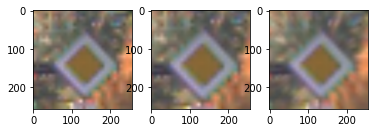

In [ ]:
train_data = get_train_loader(img_size=256)

for i, data in enumerate(train_data):
  plt.subplot(1, 3, 1)
  img, label = data
  plt.imshow(img[0].permute(1,2,0))

  plt.subplot(1, 3, 2)
  blur_layer = transforms.functional.center_crop(img[0], 236)
  blur_layer = transforms.functional.resize(blur_layer, 256)
  plt.imshow(blur_layer.permute(1,2,0))

  plt.subplot(1, 3, 3)
  merge = img[0]*0.5+blur_layer*0.5
  plt.imshow(merge.permute(1,2,0))


  if i>=0:
    break

In [ ]:
img[0]*0.5

tensor([[[0.0549, 0.0549, 0.0549,  ..., 0.0902, 0.0902, 0.0902],
         [0.0549, 0.0549, 0.0549,  ..., 0.0902, 0.0902, 0.0902],
         [0.0549, 0.0549, 0.0549,  ..., 0.0902, 0.0902, 0.0902],
         ...,
         [0.1667, 0.1667, 0.1667,  ..., 0.1235, 0.1235, 0.1235],
         [0.1667, 0.1667, 0.1667,  ..., 0.1235, 0.1235, 0.1235],
         [0.1667, 0.1667, 0.1667,  ..., 0.1235, 0.1235, 0.1235]],

        [[0.0882, 0.0882, 0.0882,  ..., 0.0843, 0.0843, 0.0843],
         [0.0882, 0.0882, 0.0882,  ..., 0.0843, 0.0843, 0.0843],
         [0.0882, 0.0882, 0.0882,  ..., 0.0843, 0.0843, 0.0843],
         ...,
         [0.1667, 0.1667, 0.1667,  ..., 0.1157, 0.1157, 0.1157],
         [0.1667, 0.1667, 0.1667,  ..., 0.1157, 0.1157, 0.1157],
         [0.1667, 0.1667, 0.1667,  ..., 0.1157, 0.1157, 0.1157]],

        [[0.1176, 0.1176, 0.1176,  ..., 0.1039, 0.1039, 0.1039],
         [0.1176, 0.1176, 0.1176,  ..., 0.1039, 0.1039, 0.1039],
         [0.1176, 0.1176, 0.1176,  ..., 0.1039, 0.1039, 0.

In [ ]:
pip install opensimplex

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import opensimplex
import numpy as np

In [ ]:
brown_rgb = np.array([139,69,19])/256
brown = torch.from_numpy(np.full((256,256,3), brown_rgb))
white = torch.from_numpy(np.full((256,256,3), 1.0))

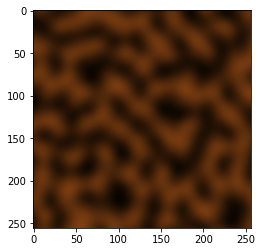

In [ ]:
plt.imshow(s*brown)

In [ ]:
s=torch.from_numpy(np.array(im)/256)

In [ ]:
s = torch.from_numpy(np.full([3, 256,256], s)).permute(1,2,0)

In [ ]:
def generate_simplex_noise(feature_size = 40):
  im = np.zeros([256,256])
  for y in range(0, HEIGHT):
      for x in range(0, WIDTH):
          value = simplex.noise2(x / FEATURE_SIZE, y / FEATURE_SIZE)
          color = (value + 1) * 0.5
          im[x,y] = color
  s = torch.from_numpy(np.full([3, 256,256], im)).permute(1,2,0)

  brown_rgb = np.array([139,69,19])/256
  brown = torch.from_numpy(np.full((256,256,3), brown_rgb))

  plt.imshow(s*brown)


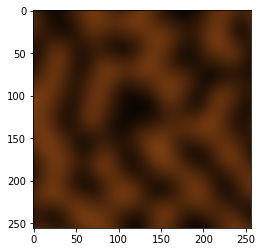

In [ ]:
generate_simplex_noise(feature_size = 40)

In [ ]:
128/256

0.5

# Autoencoder with Alexnet Features

The idea is to use am autoencoder on the Alexnet Features. The goal of all of this is to increase the emnbedding. AlexNet as been built to classify images from many classes, maybe it is possible to find a better embedding specific to traffic signs.

Morevover, we could visualize the distribution of the images from different classes. It can provide a better insight in our dataset, for example we could find out which classes are seen sinilar by the autoencoder and if we need to train specific nets to distinguish these classes.

Finally, with a denoising AE, we could generate new images that might be used for data augmentation.

## Data acquisition

In [ ]:
ae_train_loader = train_loader
ae_val_loader = val_loader
ae_test_loader = test_loader

NameError: ignored

Overfit dataset to debug the model

In [ ]:
def get_debug_loader(nb_sample=64, batch_size=64):
  # Rescale images to all be the same size
  data_transform = transforms.Compose([transforms.Resize((50,50)), 
                                       transforms.ToTensor()])

  # Get paths to data in folder
  debug_data = datasets.GTSRB('data', download=True, split="train",
                        transform=data_transform)
  #print(len(debug_data))
  debug_data = list(debug_data)
  debug_data = debug_data[:nb_sample]
  #print(len(debug_data))

  np.random.seed(1000)
  debug_loader = torch.utils.data.DataLoader(debug_data, batch_size=batch_size,
        num_workers=0, shuffle=True)
  return debug_loader

In [ ]:
ae_debug_loader = get_debug_loader(nb_sample=64, batch_size=64)

Test on plotting images

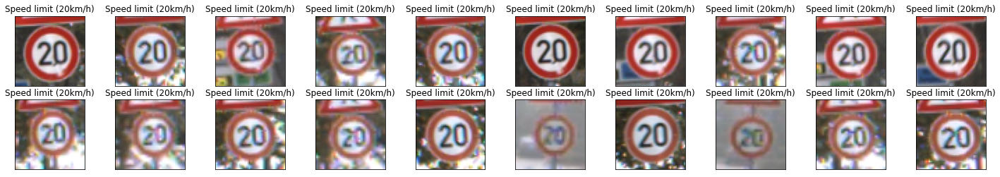

In [ ]:
dataiter = iter(ae_debug_loader)

images, labels = dataiter.next()
images = images.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 4))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(classes[labels[idx].item()])

## Useful Functions

In [ ]:
# Function to obtain loss
def get_loss_ae(model, data_loader, criterion):
  loss = 0.0
  total_loss = 0.0
  for imgs, labels in data_loader:
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
    #############################################
    output = model(imgs)
    imgs = imgs.view(-1, 3 * 50 * 50)
    loss = criterion(output, imgs)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader)) #Average loss per batch
  return loss

## Linear Autoencoder

In [ ]:
images[idx].shape

(3, 50, 50)

In [ ]:
class Linear_Autoencoder(nn.Module):
    def __init__(self):
        super(Linear_Autoencoder, self).__init__()
        encoding_dim = 32
        # encoder
        self.fc1 = nn.Linear(3 * 50 * 50, encoding_dim)
        # decoder
        self.fc2 = nn.Linear(encoding_dim, 3 * 50 * 50)

    def forward(self, img):
        flattened = img.view(-1, 3 * 50 * 50)
        x = F.relu(self.fc1(flattened))
        # sigmoid for scaling output from 0 to 1
        x = F.sigmoid(self.fc2(x))
        return x

In [ ]:
def train(model, train_loader, val_loader, num_epochs=5, batch_size=64, learning_rate=1e-3, plot_every = 50):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    iters, train_loss, val_loss = [], [], []
    n = 0

    ##To get reconstructed images at each epoch
    #outputs = []

    for epoch in range(num_epochs):
        for data in train_loader:
            img, _ = data
            img = img.view(-1, 3 * 50 * 50)

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              img = img.cuda()
            #############################################

            recon = model(img)
            loss = criterion(recon, img)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if n % plot_every == 0:
              
              train_loss.append(loss.item())
              val_loss.append(get_loss_ae(model, val_loader, criterion))
              iters.append(n+1)

              print('Iter:{}, Train Loss:{:.4f}, Val Loss:{:.4f}'.format(iters[-1], 
                                                                         float(train_loss[-1]),
                                                                         float(val_loss[-1])))
            n = n + 1

        ##To get reconstructed images at each epoch
        #outputs.append((epoch, img, recon),)


    # plotting
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("Loss Curve")
    plt.plot(iters, train_loss, label="Train")
    plt.plot(iters, val_loss, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend(loc='best')

    print("\n\nFinal Training Loss: {}".format(train_loss[-1]))
    print("Final Validation Loss: {}".format(val_loss[-1]))
    
    ##To get reconstructed images at each epoch
    #return outputs

Test to overfit the small dataset

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1960: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


Iter:1, Train Loss:0.0563, Val Loss:0.1179
Iter:21, Train Loss:0.0537, Val Loss:0.1037
Iter:41, Train Loss:0.0527, Val Loss:0.1033
Iter:61, Train Loss:0.0516, Val Loss:0.1030
Iter:81, Train Loss:0.0507, Val Loss:0.1027


Final Training Loss: 0.05068998411297798
Final Validation Loss: 0.10269767769436905


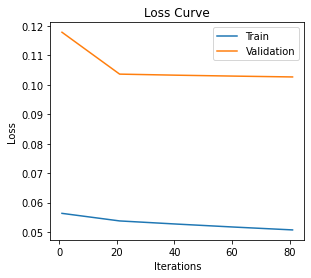

In [ ]:
use_cuda = True

model = Linear_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model.cuda()
#############################################

train(model, ae_debug_loader, ae_val_loader, num_epochs= 100, batch_size=64, learning_rate=1e-3, plot_every = 20)

On real ttrain set

In [ ]:
len(ae_train_loader)

417

Iter:1, Train Loss:0.1079, Val Loss:0.1151
Iter:51, Train Loss:0.1020, Val Loss:0.1002
Iter:101, Train Loss:0.0892, Val Loss:0.0965
Iter:151, Train Loss:0.0921, Val Loss:0.0933
Iter:201, Train Loss:0.0946, Val Loss:0.0906
Iter:251, Train Loss:0.0863, Val Loss:0.0883
Iter:301, Train Loss:0.0896, Val Loss:0.0862
Iter:351, Train Loss:0.0752, Val Loss:0.0795
Iter:401, Train Loss:0.0795, Val Loss:0.0669
Iter:451, Train Loss:0.0761, Val Loss:0.0641
Iter:501, Train Loss:0.0664, Val Loss:0.0637
Iter:551, Train Loss:0.0531, Val Loss:0.0577
Iter:601, Train Loss:0.0468, Val Loss:0.0539
Iter:651, Train Loss:0.0535, Val Loss:0.0538
Iter:701, Train Loss:0.0563, Val Loss:0.0521
Iter:751, Train Loss:0.0404, Val Loss:0.0512
Iter:801, Train Loss:0.0417, Val Loss:0.0513
Iter:851, Train Loss:0.0377, Val Loss:0.0497
Iter:901, Train Loss:0.0421, Val Loss:0.0468
Iter:951, Train Loss:0.0481, Val Loss:0.0459
Iter:1001, Train Loss:0.0483, Val Loss:0.0461
Iter:1051, Train Loss:0.0448, Val Loss:0.0438
Iter:1101, 

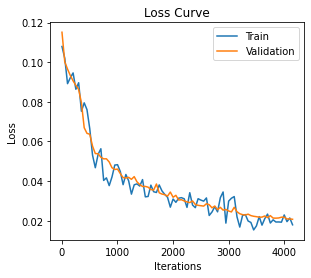

In [ ]:
use_cuda = True

model = Linear_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model.cuda()
#############################################

train(model, ae_train_loader, ae_val_loader, num_epochs= 10, batch_size=64, learning_rate=1e-3, plot_every = 50)

## CNN AE

Test on the size of the images

In [ ]:
image = torch.tensor(images[idx])
print("Size of image", image.shape)

Size of image torch.Size([3, 50, 50])


In [ ]:
conv = nn.Conv2d(in_channels=3,
                 out_channels=8,
                 kernel_size=5)

x = image
y = conv(x)


convt = nn.ConvTranspose2d(in_channels=8,
                           out_channels=3,
                           kernel_size=5)
convt(y).shape # should be same as x.shape

print("Shape of x:", x.shape)
print("Shape of y:", y.shape)
print("Shape of x':", convt(y).shape)

Shape of x: torch.Size([3, 50, 50])
Shape of y: torch.Size([8, 46, 46])
Shape of x': torch.Size([3, 50, 50])


In [ ]:
x = image


## Encoder
print("Shape of x:", x.shape)
emb = nn.Conv2d(3, 16, 3, stride=2, padding=1)(x)
print(emb.shape)
emb = nn.Conv2d(16, 32, 3, stride=2, padding=1)(emb)
print(emb.shape)
emb = nn.Conv2d(32, 16, 7, stride=2, padding=1)(emb)
print(emb.shape)
emb = nn.Conv2d(16, 3, 3, stride=2, padding=1)(emb)

print("\nShape of embedding:", emb.shape, end = "\n\n")

## Decoder
y = nn.ConvTranspose2d(3, 16, 3, stride=2, padding=1, output_padding=0)(emb)
print(y.shape)
y = nn.ConvTranspose2d(16, 32, 7, stride=2, padding=1, output_padding=0)(y)
print(y.shape)
y = nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=0)(y)
print(y.shape)
y = nn.ConvTranspose2d(16, 3, 3, stride=2, padding=1, output_padding=1)(y)
print("Shape of x':", y.shape)

Shape of x: torch.Size([3, 50, 50])
torch.Size([16, 25, 25])
torch.Size([32, 13, 13])
torch.Size([16, 5, 5])

Shape of embedding: torch.Size([3, 3, 3])

torch.Size([16, 5, 5])
torch.Size([32, 13, 13])
torch.Size([16, 25, 25])
Shape of x': torch.Size([3, 50, 50])


**Architecture**

In [ ]:
class CNN_Autoencoder(nn.Module):
    def __init__(self):
        super(CNN_Autoencoder, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
                                     
            nn.Conv2d(3, 16, 3, stride=2, padding=1),                         
            nn.ReLU(),
            nn.Conv2d(16, 32, 3, stride=2, padding=1),                         
            nn.ReLU(),
            nn.Conv2d(32, 16, 7, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, 3, 3, stride=2, padding=1),

        )
        self.decoder = nn.Sequential(
            
            nn.ConvTranspose2d(3, 16, 3, stride=2, padding=1, output_padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 32, 7, stride=2, padding=1, output_padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=0),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 3, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        emb = self.encoder(x)
        y = self.decoder(emb)
        return y, emb

Shape of x: torch.Size([3, 50, 50])
Shape of embedding: torch.Size([3, 3, 3])
Shape of y: torch.Size([3, 50, 50])


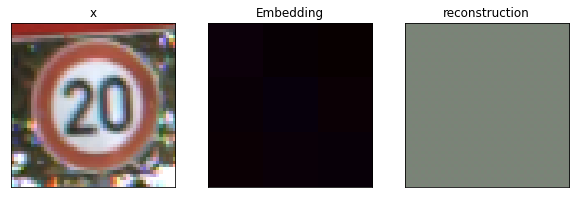

In [ ]:
cnn_model = CNN_Autoencoder()

y, emb = cnn_model(x)

print('Shape of x:', x.shape)
print('Shape of embedding:', emb.shape)
print('Shape of y:', y.shape)

results = [x, emb, y]
titles = ['x', 'Embedding', 'reconstruction']

fig = plt.figure(figsize = (10,4))

for i in range(len(results)):

    ax = fig.add_subplot(1, len(results), i+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(results[i].detach().numpy(), (1, 2, 0)))
    ax.set_title(titles[i])  

plt.show()

**Training function**

In [ ]:
def get_loss_aecnn(model, data_loader, criterion):
  loss = 0.0
  total_loss = 0.0
  for imgs, labels in data_loader:
    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
    #############################################
    output,_ = model(imgs)
    loss = criterion(output, imgs)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader)) #Average loss per batch
  return loss

def train(model, train_loader, val_loader, num_epochs=5, batch_size=64, learning_rate=1e-3, plot_every = 50):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    iters, train_loss, val_loss = [], [], []
    n = 0

    ##To get reconstructed images at each epoch
    out = []

    for epoch in range(num_epochs):
        print("################## EPOCH {} ##################".format(epoch))
        for data in train_loader:
            img, _ = data

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              img = img.cuda()
            #############################################
            recon, embendding = model(img)
            loss = criterion(recon, img)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if n % plot_every == 0:
              
              train_loss.append(loss.item())
              val_loss.append(get_loss_aecnn(model, val_loader, criterion))
              iters.append(n+1)

              print('Iter:{}, Train Loss:{:.4f}, Val Loss:{:.4f}'.format(iters[-1], 
                                                                         float(train_loss[-1]),
                                                                         float(val_loss[-1])))
            n = n + 1

        ##To get reconstructed images at each epoch
        out.append((epoch, img, embendding, recon),)


    # plotting
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("Loss Curve")
    plt.plot(iters, train_loss, label="Train")
    plt.plot(iters, val_loss, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend(loc='best')

    print("\n\nFinal Training Loss: {}".format(train_loss[-1]))
    print("Final Validation Loss: {}".format(val_loss[-1]))
    
    ##To get reconstructed images at each epoch
    return out

Try to overfit

################## EPOCH 0 ##################
Iter:1, Train Loss:0.0566, Val Loss:0.1043
################## EPOCH 1 ##################
################## EPOCH 2 ##################
################## EPOCH 3 ##################
################## EPOCH 4 ##################
################## EPOCH 5 ##################
################## EPOCH 6 ##################
################## EPOCH 7 ##################
################## EPOCH 8 ##################
################## EPOCH 9 ##################
################## EPOCH 10 ##################
################## EPOCH 11 ##################
################## EPOCH 12 ##################
################## EPOCH 13 ##################
################## EPOCH 14 ##################
################## EPOCH 15 ##################
################## EPOCH 16 ##################
################## EPOCH 17 ##################
################## EPOCH 18 ##################
################## EPOCH 19 ##################
################## EPOCH 20

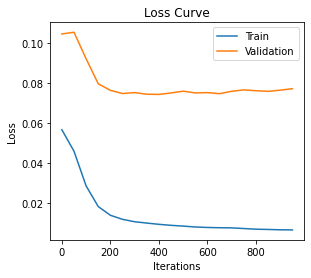

In [ ]:
use_cuda = True

model = CNN_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model.cuda()
#############################################
max_epochs = 1000
outputs = train(model, ae_debug_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 50)

**Visualisation**

In [ ]:
# reconstructed images at various parts of training

def visualize_training (outputs, plot_every = 1):
  """ Show the evolution of the embendding and the reconstruction during the training

      Args:
          outputs: A list of [[input images, embenddings, reconstructions]]
          plot_every: number of epoch to plot images
      
      Returns:
          None 
    """


  for k in range(0, len(outputs), plot_every):
      plt.figure(figsize=(18, 6))
      imgs = outputs[k][1].cpu().detach().numpy()
      emb = outputs[k][2].cpu().detach().numpy()
      recon = outputs[k][3].cpu().detach().numpy()

      for i, item in enumerate(imgs):
          if i >= 9: break
          plt.subplot(3, 9, i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))
          plt.title("Epoch " + str(k))

          if(i == 0):
            plt.ylabel("Input")
          
      for i, item in enumerate(emb):
          if i >= 9: break
          plt.subplot(3, 9, 9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Embendding")

      for i, item in enumerate(recon):
          if i >= 9: break
          plt.subplot(3, 9, 9+9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Reconstruction")

  plt.show()

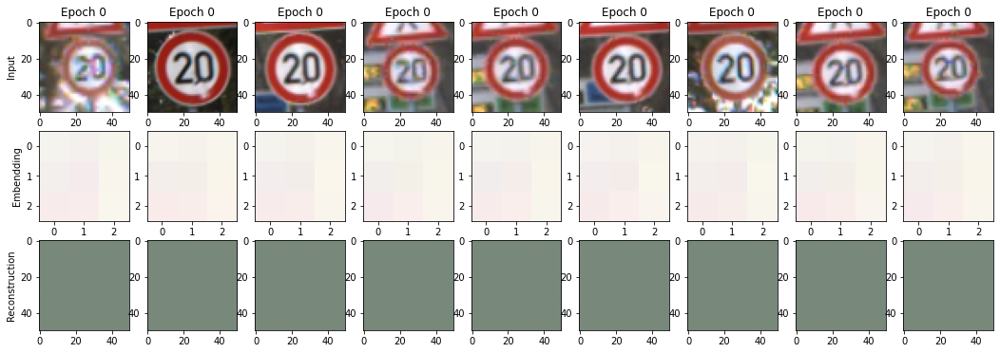

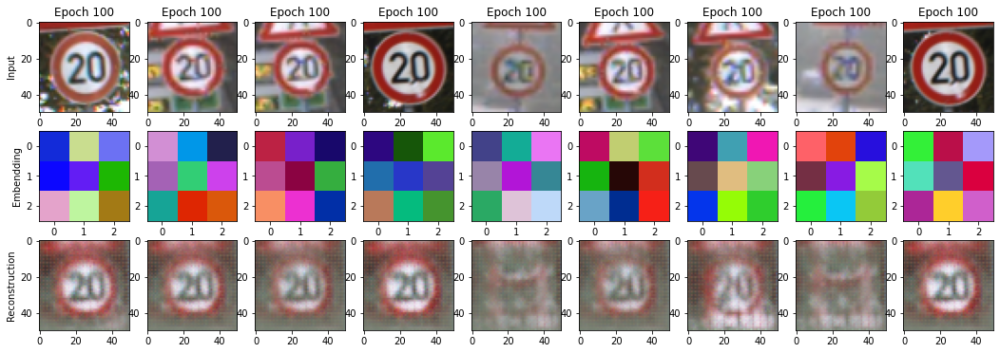

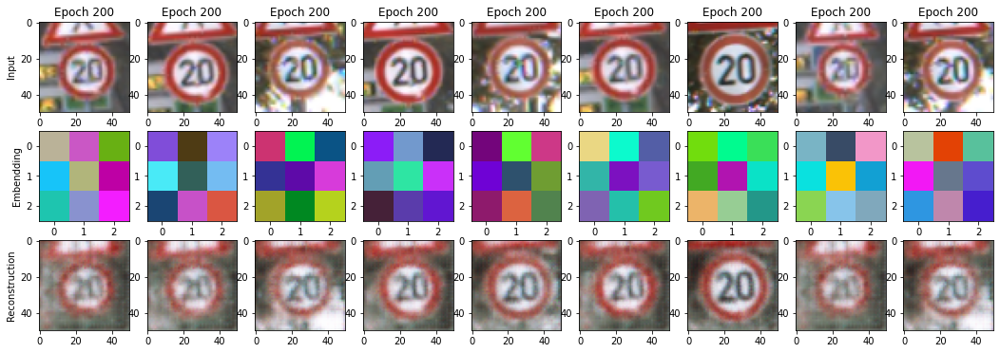

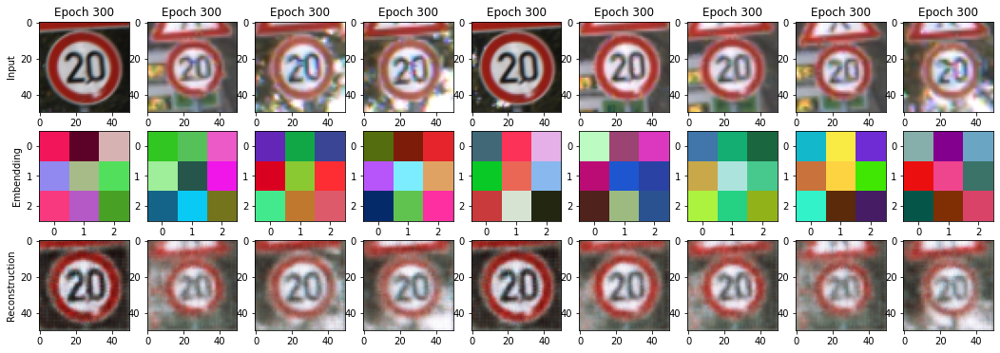

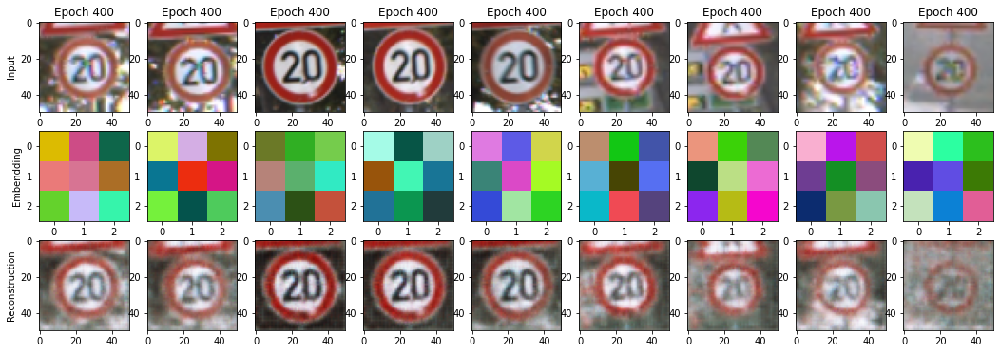

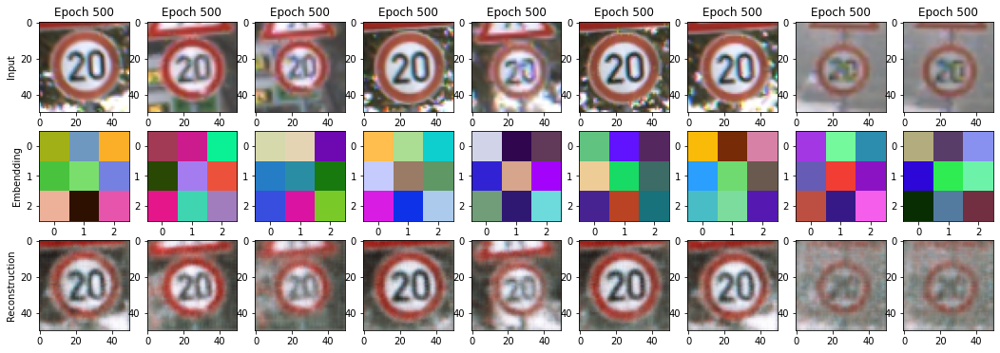

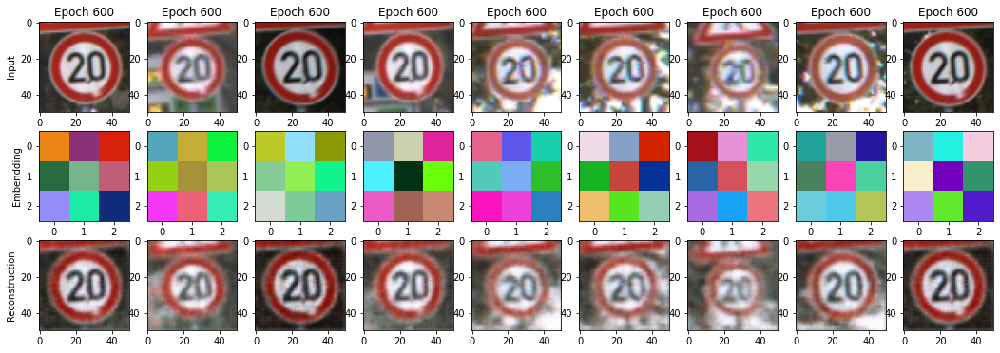

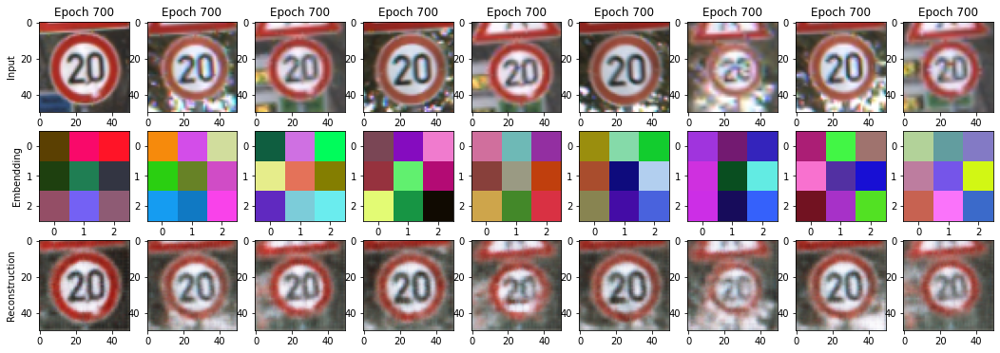

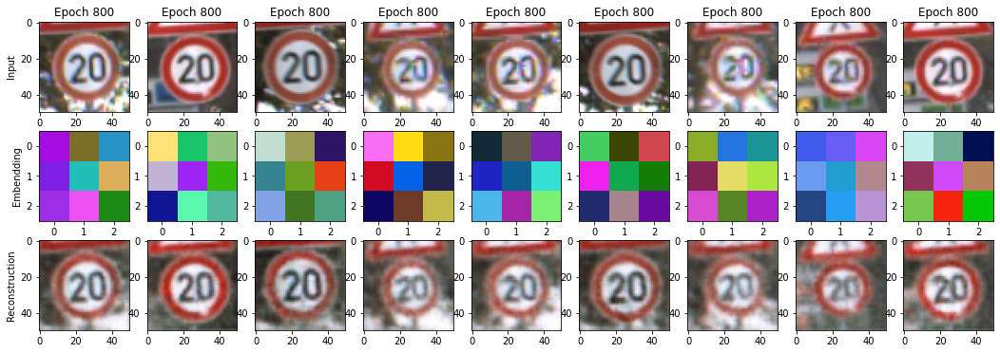

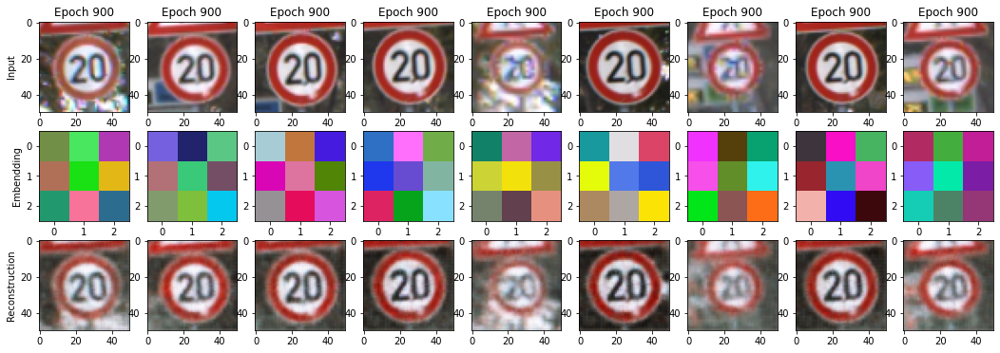

In [ ]:
visualize_training (outputs, max_epochs)

Train on all the dataset

################## EPOCH 0 ##################
Iter:1, Train Loss:0.1127, Val Loss:0.1091
Iter:101, Train Loss:0.0325, Val Loss:0.0294
Iter:201, Train Loss:0.0187, Val Loss:0.0210
Iter:301, Train Loss:0.0223, Val Loss:0.0200
Iter:401, Train Loss:0.0192, Val Loss:0.0186
################## EPOCH 1 ##################
Iter:501, Train Loss:0.0216, Val Loss:0.0181
Iter:601, Train Loss:0.0175, Val Loss:0.0173
Iter:701, Train Loss:0.0171, Val Loss:0.0172
Iter:801, Train Loss:0.0186, Val Loss:0.0168
################## EPOCH 2 ##################
Iter:901, Train Loss:0.0169, Val Loss:0.0165
Iter:1001, Train Loss:0.0168, Val Loss:0.0168
Iter:1101, Train Loss:0.0162, Val Loss:0.0160
Iter:1201, Train Loss:0.0145, Val Loss:0.0160
################## EPOCH 3 ##################
Iter:1301, Train Loss:0.0187, Val Loss:0.0165
Iter:1401, Train Loss:0.0158, Val Loss:0.0157
Iter:1501, Train Loss:0.0140, Val Loss:0.0152
Iter:1601, Train Loss:0.0142, Val Loss:0.0151
################## EPOCH 4 ##################


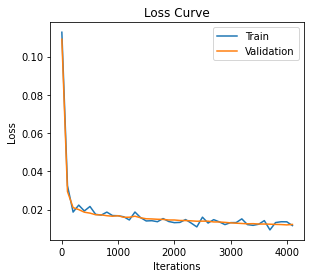

In [ ]:
use_cuda = True

model = CNN_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model.cuda()
#############################################
max_epochs = 10
outputs1 = train(model, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 100)

**Visualization**

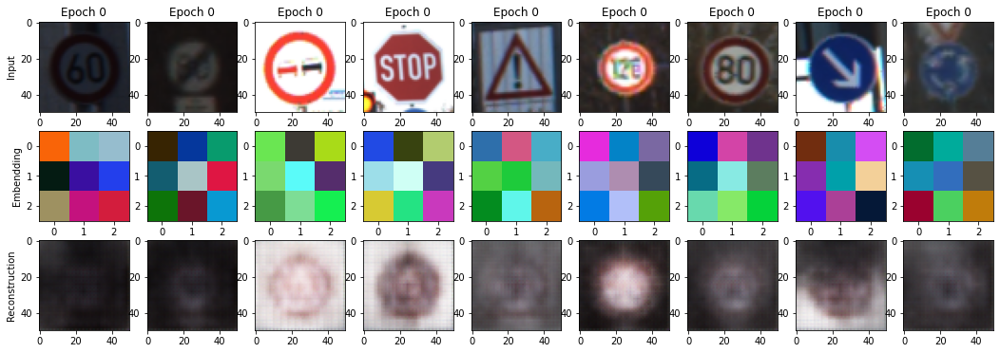

In [ ]:
visualize_training (outputs1, max_epochs)

Not really good at reconstruction, maybe the encoding dimension is to small.

Firstly, I will try to tune the hyperparameters: increase teh number of epochs maybe we didn't reach the minimum.


**Model 2:** Number of epochs = 30

################## EPOCH 0 ##################
Iter:1, Train Loss:0.1038, Val Loss:0.1001
################## EPOCH 1 ##################
Iter:501, Train Loss:0.0203, Val Loss:0.0187
################## EPOCH 2 ##################
Iter:1001, Train Loss:0.0145, Val Loss:0.0170
################## EPOCH 3 ##################
Iter:1501, Train Loss:0.0145, Val Loss:0.0154
################## EPOCH 4 ##################
Iter:2001, Train Loss:0.0148, Val Loss:0.0138
################## EPOCH 5 ##################
Iter:2501, Train Loss:0.0118, Val Loss:0.0131
################## EPOCH 6 ##################
################## EPOCH 7 ##################
Iter:3001, Train Loss:0.0140, Val Loss:0.0125
################## EPOCH 8 ##################
Iter:3501, Train Loss:0.0117, Val Loss:0.0123
################## EPOCH 9 ##################
Iter:4001, Train Loss:0.0127, Val Loss:0.0119
################## EPOCH 10 ##################
Iter:4501, Train Loss:0.0118, Val Loss:0.0117
################## EPOCH 11 #########

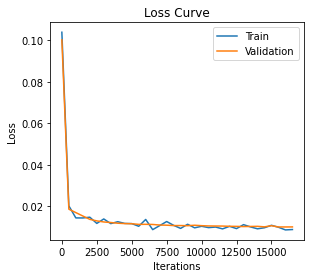

In [ ]:
use_cuda = True

model2 = CNN_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model2.cuda()
#############################################
max_epochs = 40
outputs2 = train(model2, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 500)

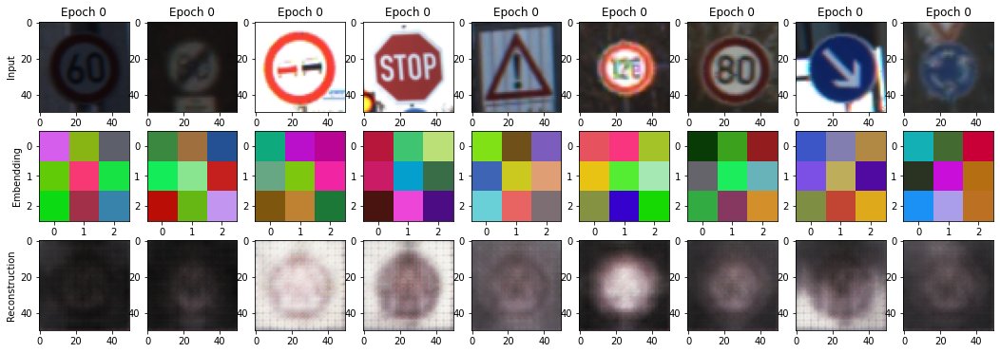

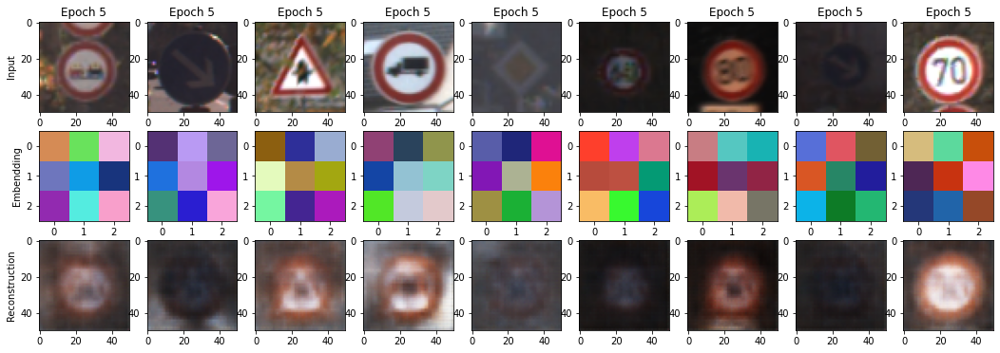

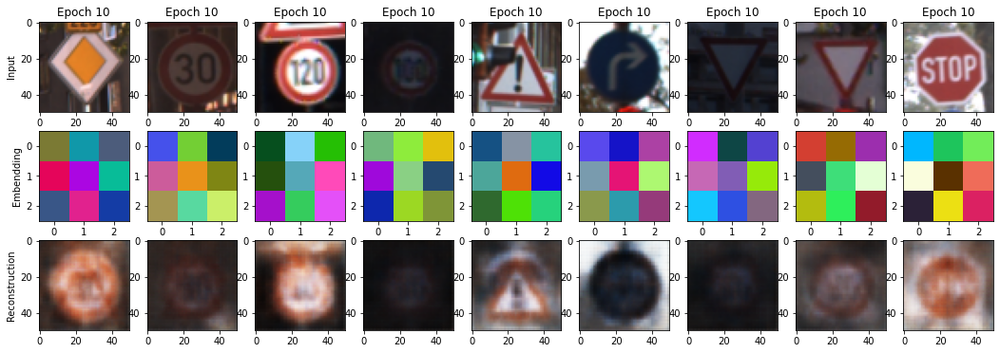

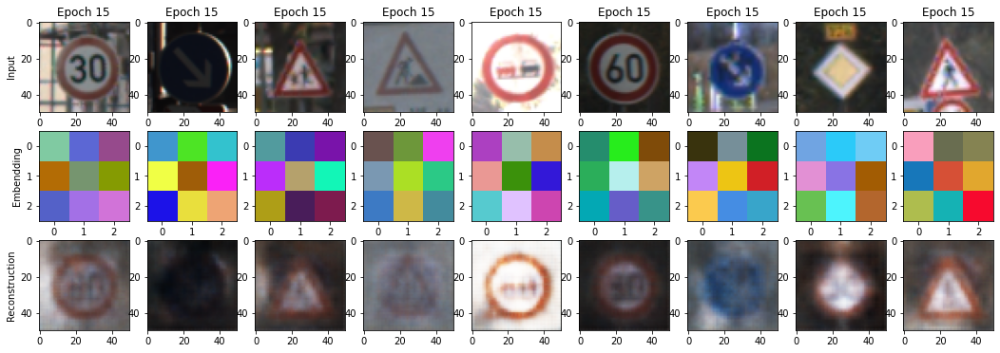

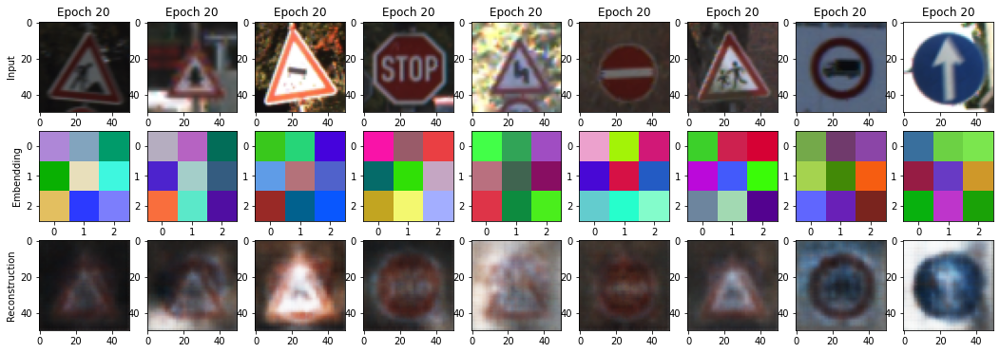

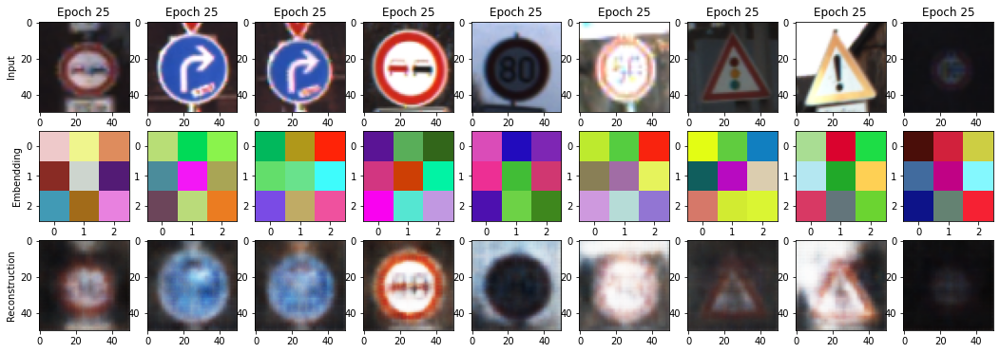

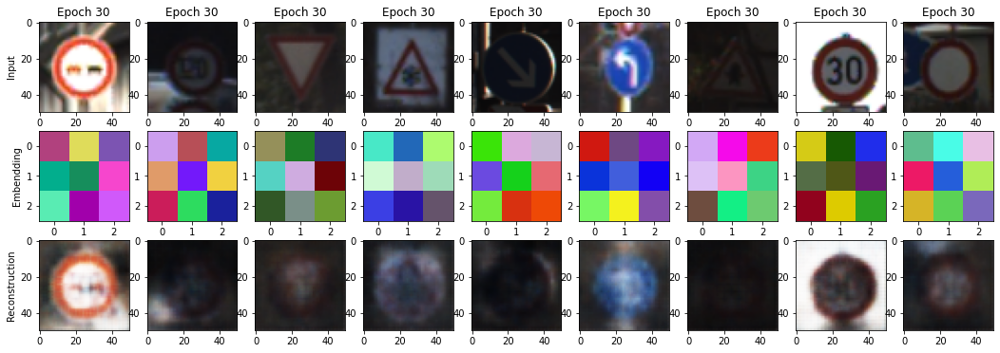

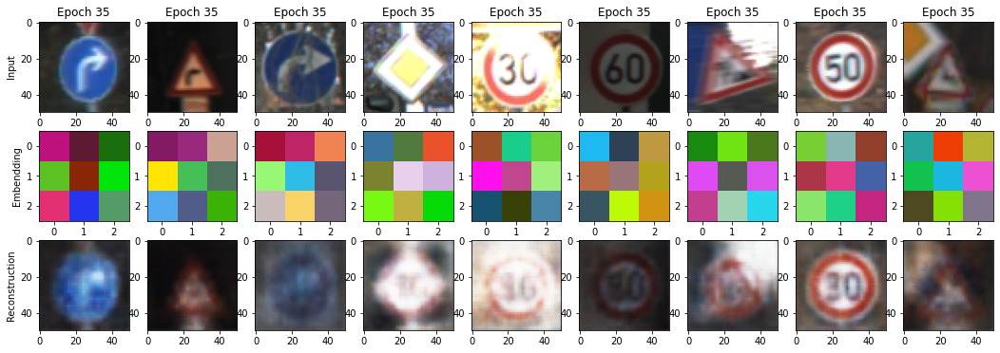

In [ ]:
visualize_training (outputs2, plot_every = 5)

It is way better !

The issue I think is that we have to many speed limitation signs, so the Autoencoder is trying to map every sign to circual sign.

Another issue is that we have different lighting of images. Most of them are very bright and others are very dark. So the model is seeing really dark images as only black pictures.

**Model 3:** change Relu to leakyRelu to see if the training is faster, actually it was and the model seems to overfit with lr=1e-3 so I changed it to lr = 1e-4

In [ ]:
class CNN_Autoencoder_v2(nn.Module):
    def __init__(self):
        super(CNN_Autoencoder_v2, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
                                     
            nn.Conv2d(3, 16, 3, stride=2, padding=1),                         
            nn.LeakyReLU(0.1),
            nn.Conv2d(16, 32, 3, stride=2, padding=1),                         
            nn.LeakyReLU(0.1),
            nn.Conv2d(32, 16, 7, stride=2, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(16, 3, 3, stride=2, padding=1),

        )
        self.decoder = nn.Sequential(
            
            nn.ConvTranspose2d(3, 16, 3, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(16, 32, 7, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(16, 3, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        emb = self.encoder(x)
        y = self.decoder(emb)
        return y, emb




use_cuda = True

model3 = CNN_Autoencoder_v2()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model3.cuda()
#############################################
max_epochs = 40
outputs3 = train(model3, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 1000)

NameError: ignored

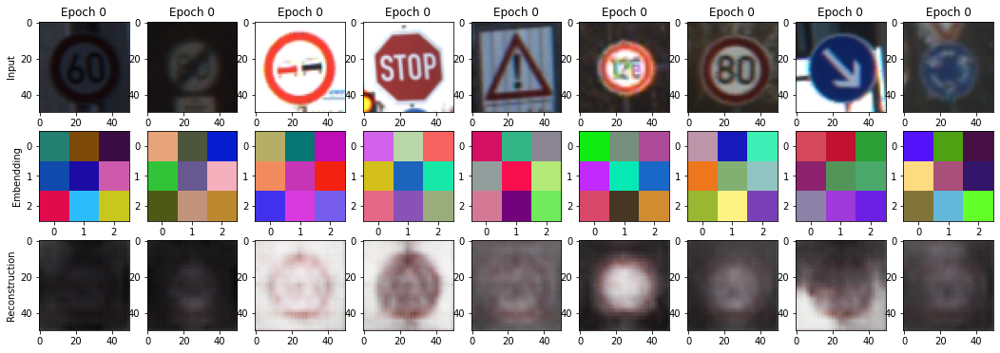

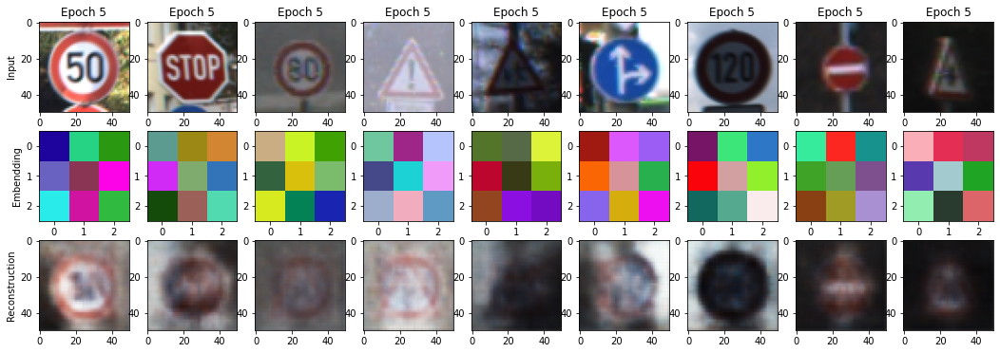

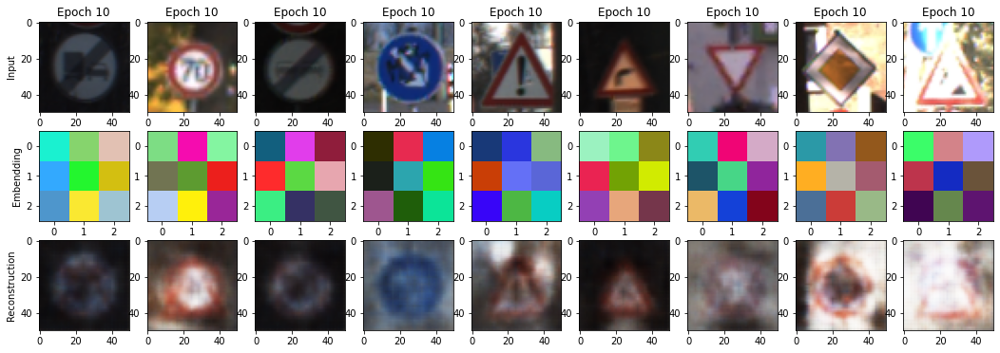

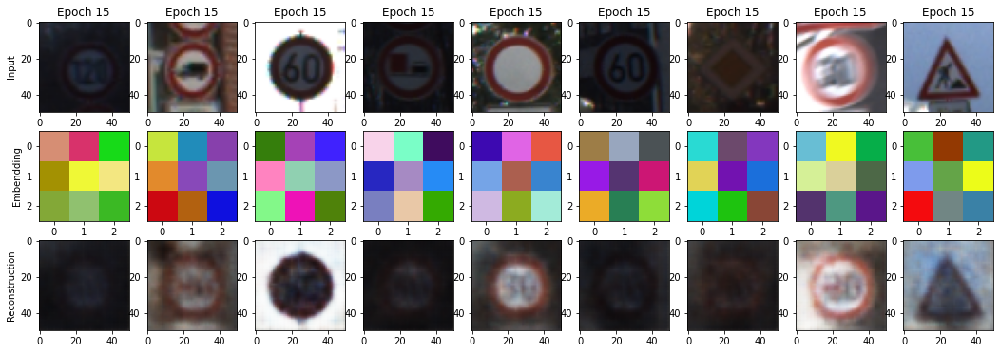

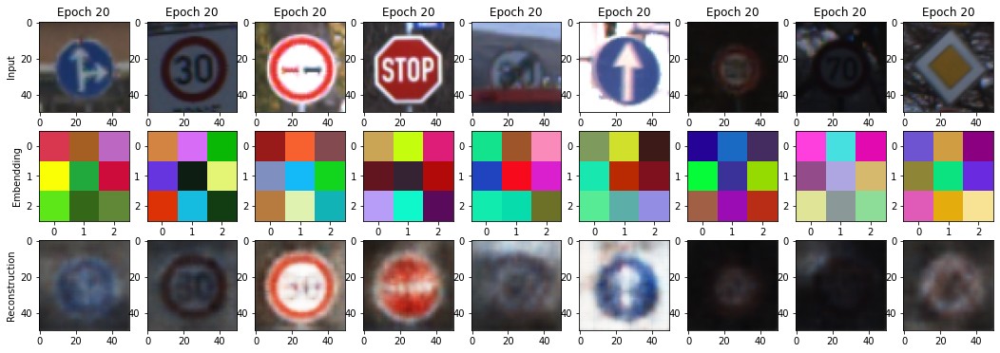

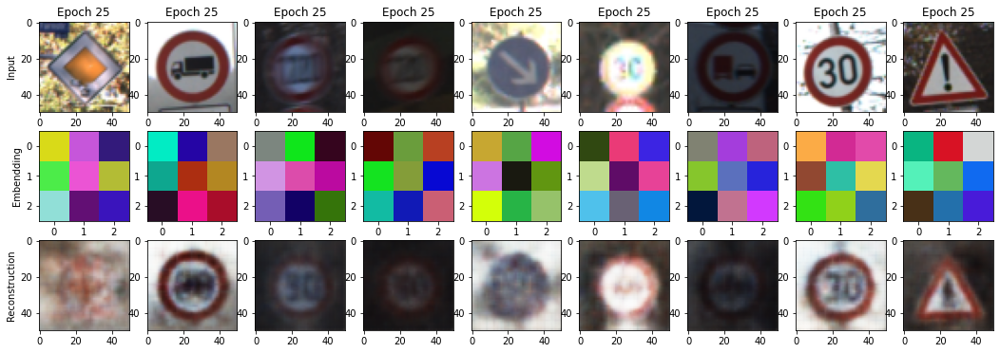

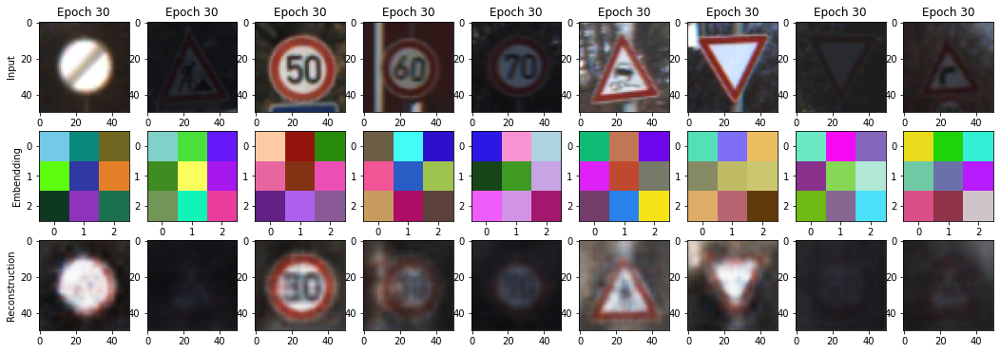

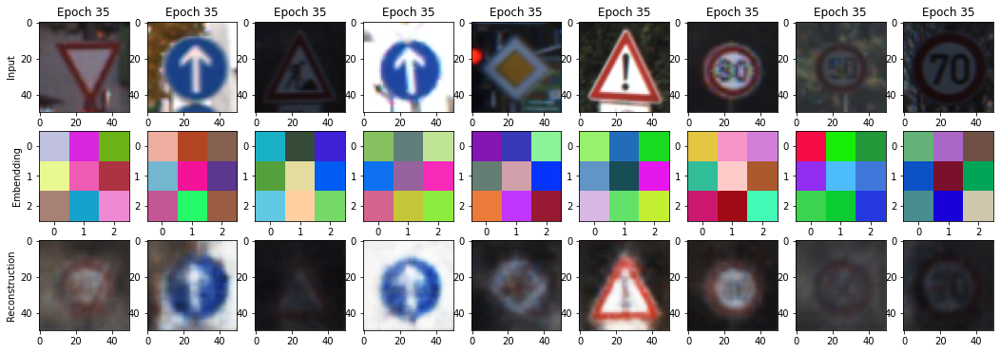

In [ ]:
visualize_training (outputs3, plot_every = 5)

**Maybe increase the number of epochs just to see if it overfits**

################## EPOCH 0 ##################
Iter:1, Train Loss:0.1140, Val Loss:0.1103
################## EPOCH 1 ##################
################## EPOCH 2 ##################
Iter:1001, Train Loss:0.0155, Val Loss:0.0140
################## EPOCH 3 ##################
################## EPOCH 4 ##################
Iter:2001, Train Loss:0.0136, Val Loss:0.0122
################## EPOCH 5 ##################
################## EPOCH 6 ##################
################## EPOCH 7 ##################
Iter:3001, Train Loss:0.0098, Val Loss:0.0112
################## EPOCH 8 ##################
################## EPOCH 9 ##################
Iter:4001, Train Loss:0.0118, Val Loss:0.0108
################## EPOCH 10 ##################
################## EPOCH 11 ##################
Iter:5001, Train Loss:0.0089, Val Loss:0.0106
################## EPOCH 12 ##################
################## EPOCH 13 ##################
################## EPOCH 14 ##################
Iter:6001, Train Loss:0.0112, Va

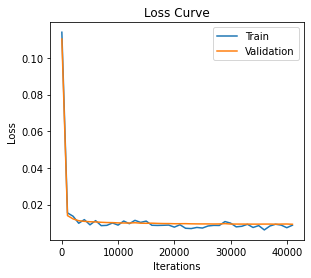

In [ ]:
use_cuda = True

model4 = CNN_Autoencoder_v2()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model4.cuda()
#############################################
max_epochs = 100
outputs4 = train(model4, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 1000)

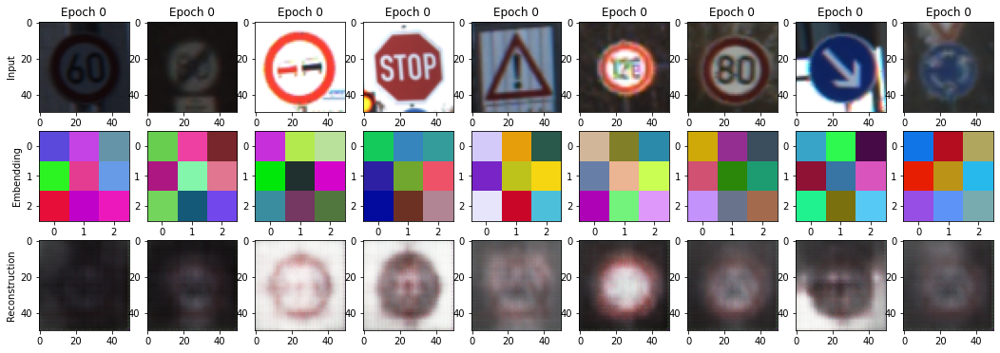

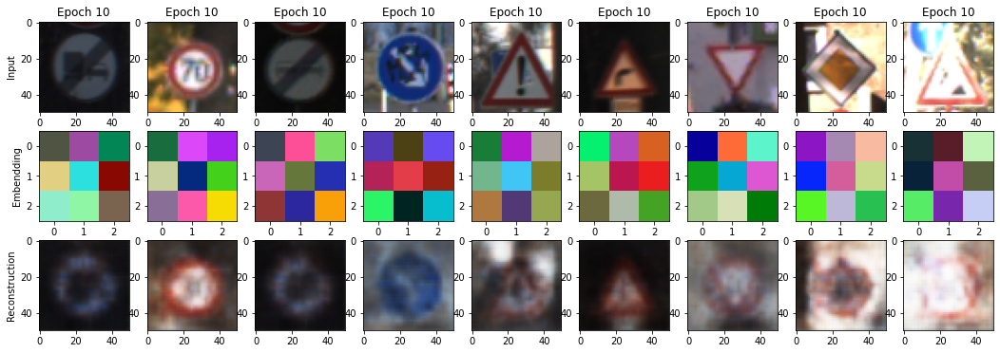

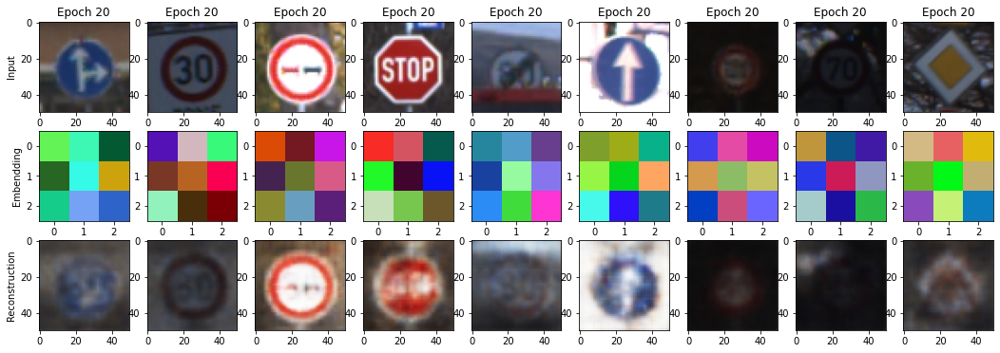

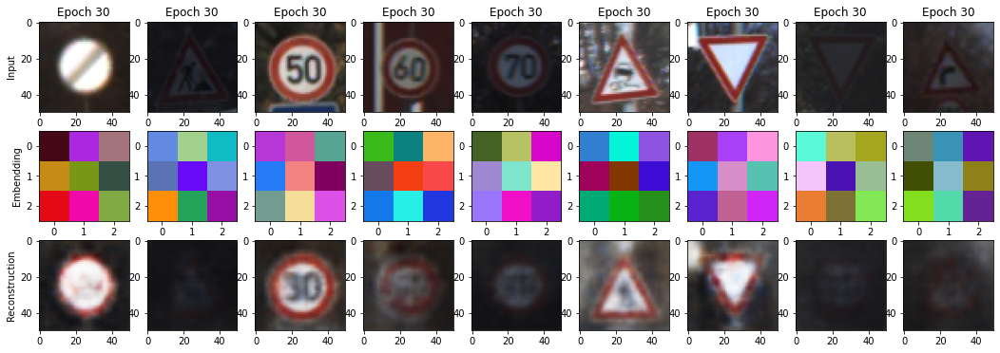

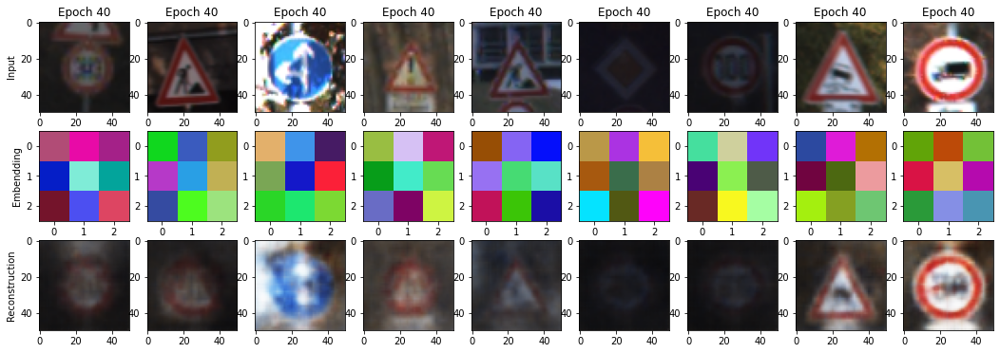

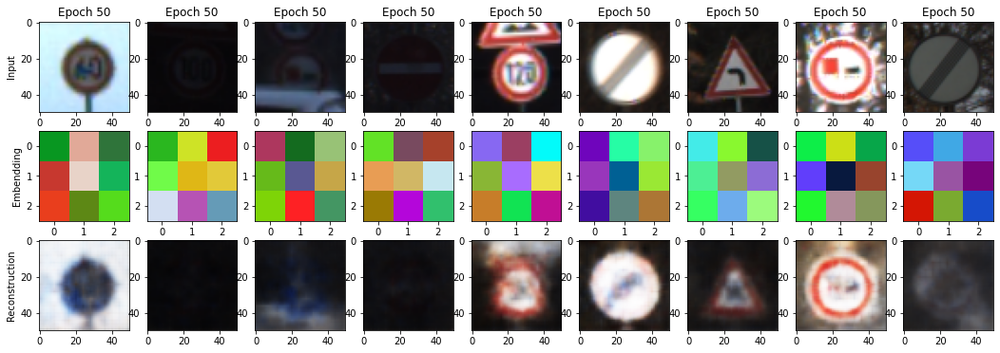

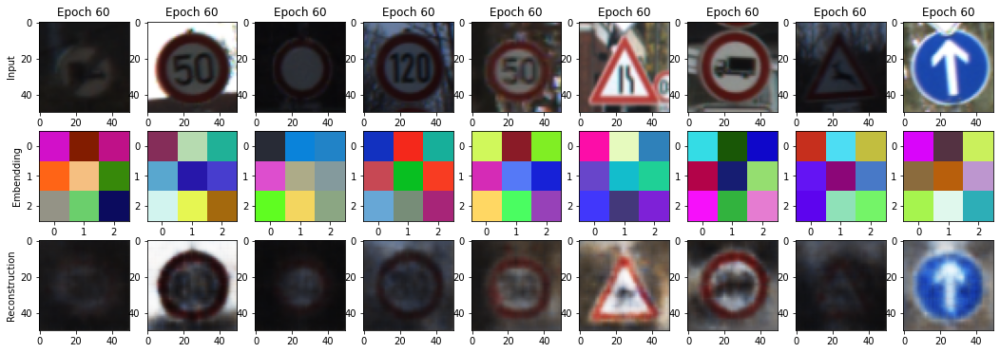

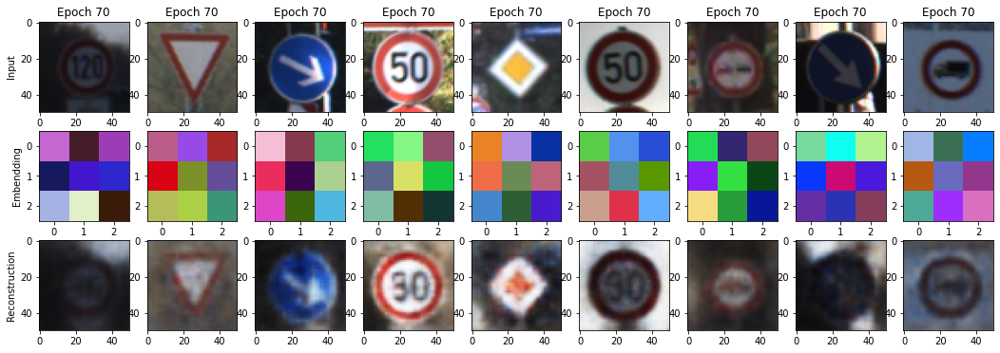

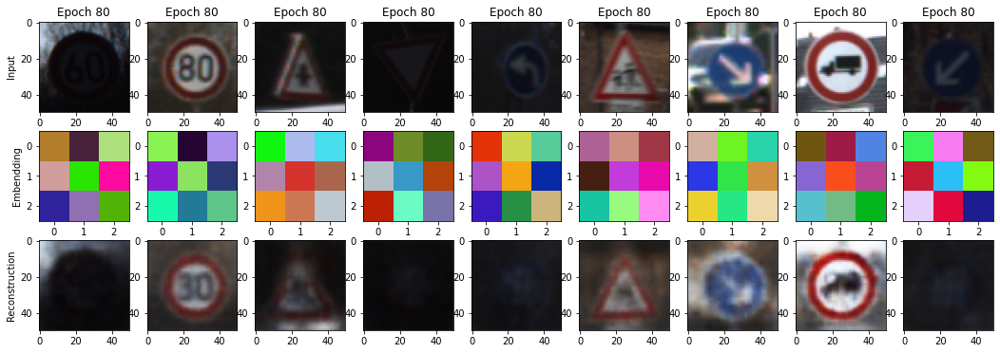

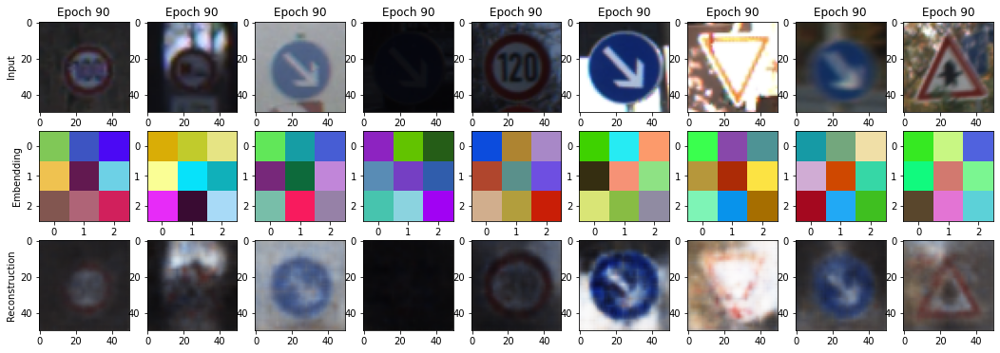

In [ ]:
visualize_training (outputs4, plot_every = 10)

It is slighty better but the model is still bad to reproduce low-represented classes.

**Following processus:**

The main idea I have is to force the model **to learn useful features** in order to spatially seperate the different classes. One simple way to evaluate if the distinction is well performed is to run a simple t-SNE algotrithm on the embendding set. It would allow us to compute the center of each cluster and to build a confidence score base on the distance of a test sample form cluster centers.

**Other idea !!!** 

Instead of computing the loss between the original image and the reconstructed image, we could compute the loss between a really clean image choosen for each class. So we have to build a really clean dataset of 'perfect' images to force the model to clean our images and turn them into perfect sample of the class.

**Issue with AlexNet features:**

We have to work with embendding features, so to visualize the results is almost impossible. We only have to focus on the loss.


**Comments on the dataset:**

Be careful, for this unbalanced dataset, the model could be lead to only focus on the ronstruction only the highly represented classes (here the speed limitation signs) to have a low average score. 

*Idea:* custom the loss function to apply weights based on the classe distribution to the loss.

## Denoising autoencoder 

*Maybe it could help to increase the definition of the input images*

In [ ]:
class CNN_Autoencoder_v2(nn.Module):
    def __init__(self):
        super(CNN_Autoencoder_v2, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
                                     
            nn.Conv2d(3, 16, 3, stride=2, padding=1),                         
            nn.LeakyReLU(0.1),
            nn.Conv2d(16, 32, 3, stride=2, padding=1),                         
            nn.LeakyReLU(0.1),
            nn.Conv2d(32, 16, 7, stride=2, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(16, 3, 3, stride=2, padding=1),

        )
        self.decoder = nn.Sequential(
            
            nn.ConvTranspose2d(3, 16, 3, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(16, 32, 7, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(0.1),
            nn.ConvTranspose2d(16, 3, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        emb = self.encoder(x)
        y = self.decoder(emb)
        return y, emb

In [ ]:
def get_loss_aecnn_noisy(model, data_loader, criterion, noise):
  loss = 0.0
  total_loss = 0.0
  for imgs, labels in data_loader:
    
    imgs_noisy = imgs + noise * torch.randn(*imgs.shape)
    imgs_noisy = np.clip(imgs_noisy, 0., 1.)

    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs_noisy = imgs_noisy.cuda()
      imgs = imgs.cuda()
    #############################################

    output,_ = model(imgs_noisy)
    loss = criterion(output, imgs)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader)) #Average loss per batch
  return loss

def train_noisy(model, train_loader, val_loader, num_epochs=5, batch_size=64, learning_rate=1e-3, plot_every = 50):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    iters, train_loss, val_loss = [], [], []
    n = 0

    ##To get reconstructed images at each epoch
    out = []

    noise = 0.25

    for epoch in range(num_epochs):
        print("################## EPOCH {} ##################".format(epoch))
        for data in train_loader:
            img, _ = data

            img_noisy = img + noise * torch.randn(*img.shape)
            img_noisy = np.clip(img_noisy, 0., 1.)

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              img_noisy = img_noisy.cuda()
              img = img.cuda()
            #############################################

            recon, embendding = model(img_noisy)
            loss = criterion(recon, img)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if n % plot_every == 0:
              
              train_loss.append(loss.item())
              val_loss.append(get_loss_aecnn_noisy(model, val_loader, criterion, noise))
              iters.append(n+1)

              print('Iter:{}, Train Loss:{:.4f}, Val Loss:{:.4f}'.format(iters[-1], 
                                                                         float(train_loss[-1]),
                                                                         float(val_loss[-1])))
            n = n + 1

        ##To get reconstructed images at each epoch
        out.append((epoch, img, img_noisy, recon),)


    # plotting
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("Loss Curve")
    plt.plot(iters, train_loss, label="Train")
    plt.plot(iters, val_loss, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend(loc='best')

    print("\n\nFinal Training Loss: {}".format(train_loss[-1]))
    print("Final Validation Loss: {}".format(val_loss[-1]))
    
    ##To get reconstructed images at each epoch
    return out

# reconstructed images at various parts of training

def visualize_training_noisy (outputs, plot_every = 1):
  """ Show the evolution of the embendding and the reconstruction during the training

      Args:
          outputs: A list of [[input images, embenddings, reconstructions]]
          plot_every: number of epoch to plot images
      
      Returns:
          None 
    """


  for k in range(0, len(outputs), plot_every):
      plt.figure(figsize=(18, 6))
      imgs = outputs[k][1].cpu().detach().numpy()
      emb = outputs[k][2].cpu().detach().numpy()
      recon = outputs[k][3].cpu().detach().numpy()

      for i, item in enumerate(imgs):
          if i >= 9: break
          plt.subplot(3, 9, i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))
          plt.title("Epoch " + str(k))

          if(i == 0):
            plt.ylabel("Input")
          
      for i, item in enumerate(emb):
          if i >= 9: break
          plt.subplot(3, 9, 9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Noisy input")

      for i, item in enumerate(recon):
          if i >= 9: break
          plt.subplot(3, 9, 9+9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Reconstruction")

  plt.show()

In [ ]:
use_cuda = True

model_noisy = CNN_Autoencoder_v2()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model_noisy.cuda()
#############################################
max_epochs = 100
outputs_noisy = train_noisy(model_noisy, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-4, plot_every = 1000)

################## EPOCH 0 ##################


KeyboardInterrupt: ignored

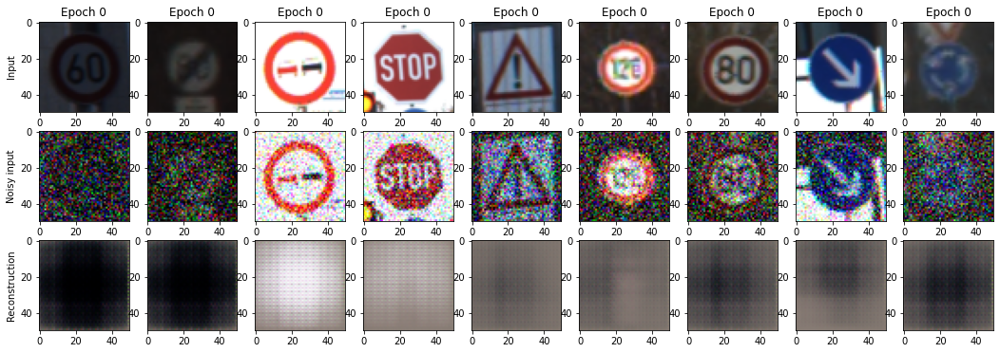

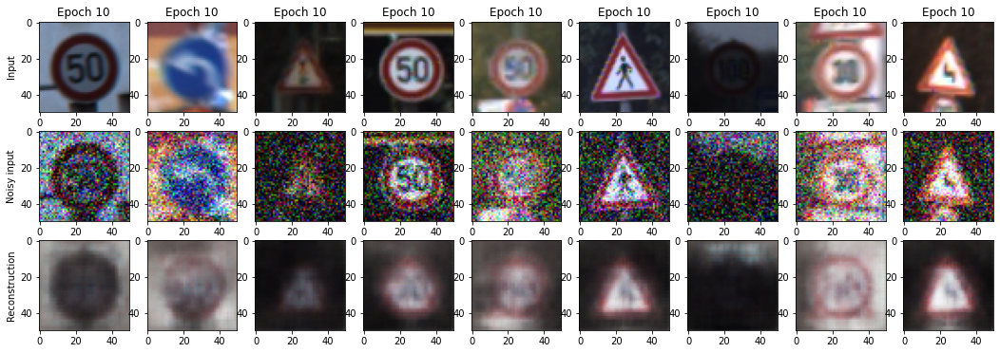

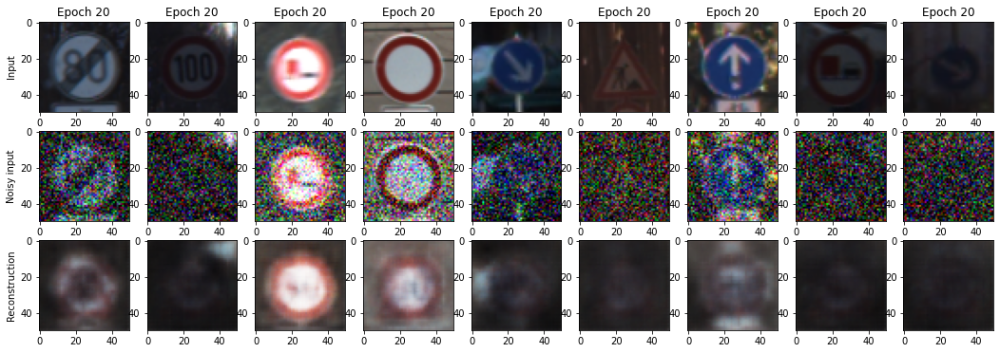

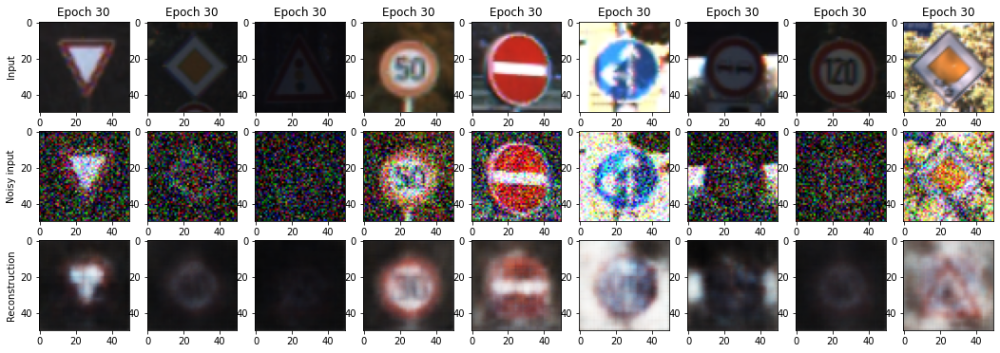

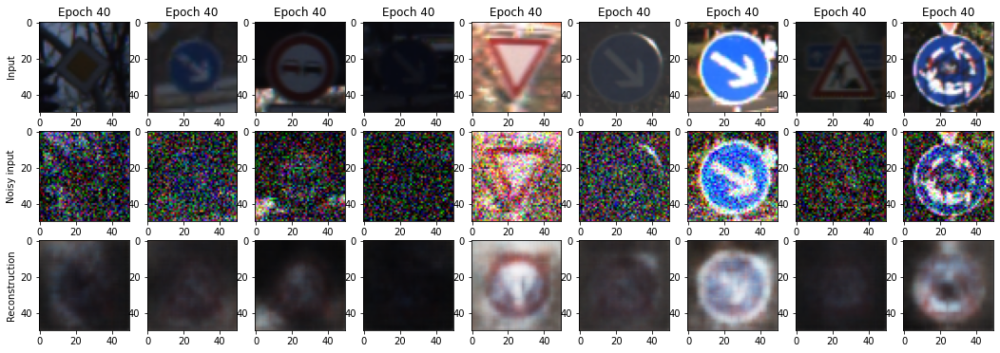

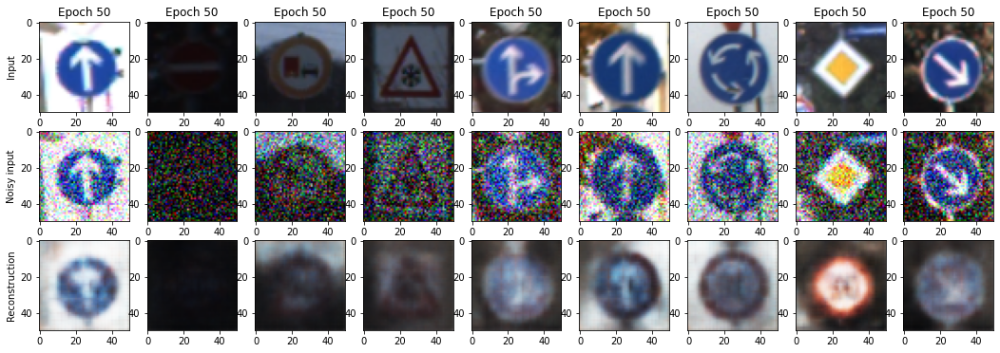

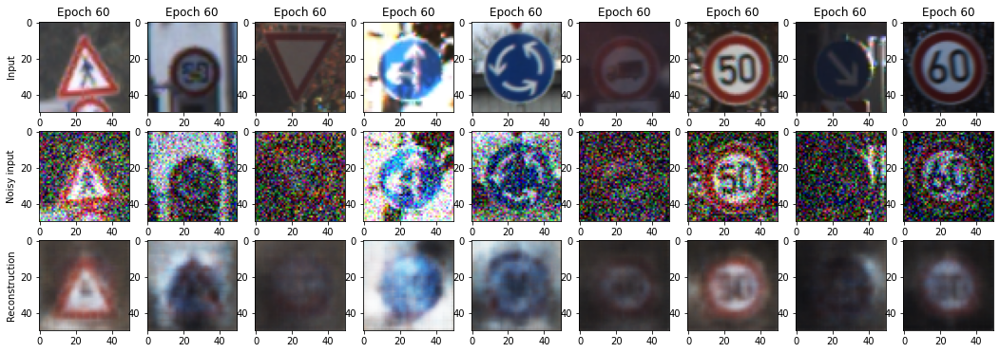

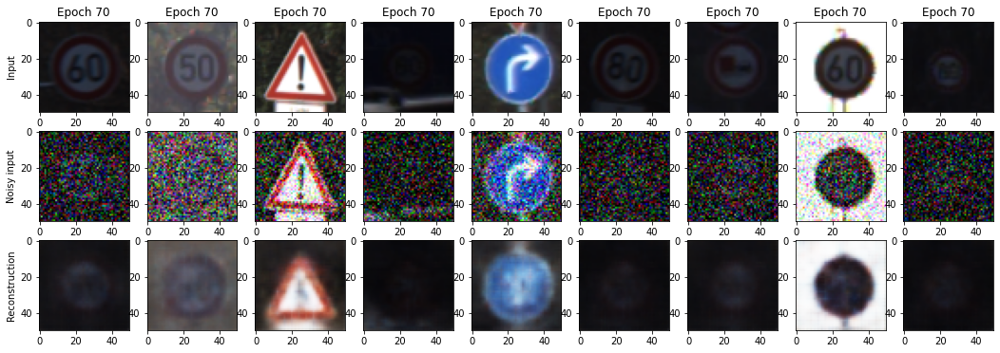

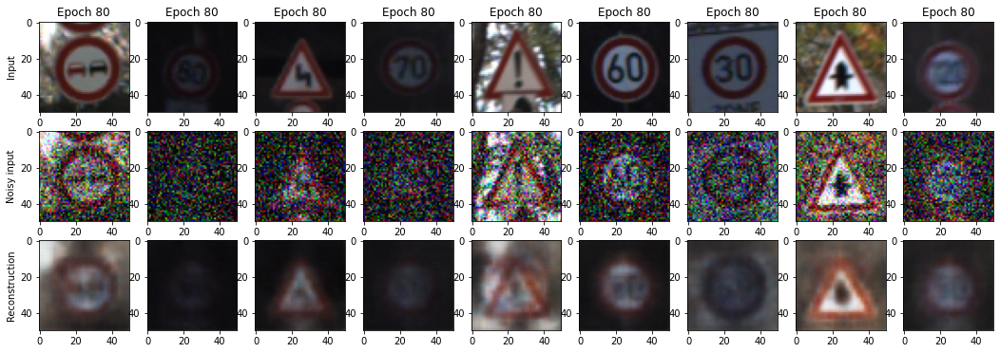

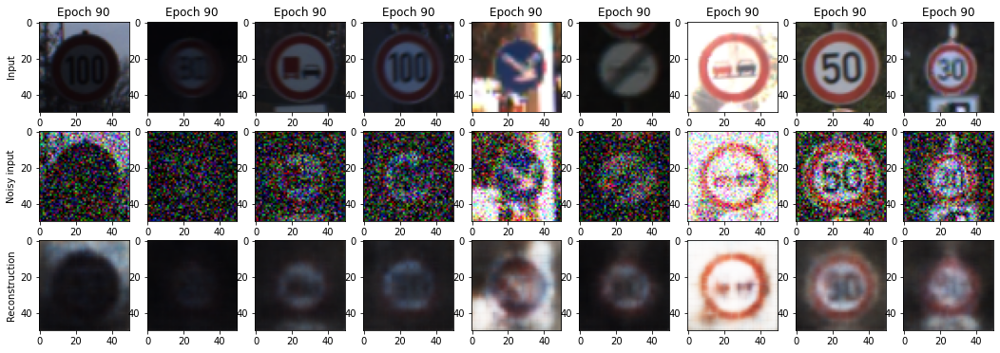

In [ ]:
visualize_training_noisy (outputs_noisy, plot_every = 10)

################## EPOCH 0 ##################
Iter:1, Train Loss:0.1051, Val Loss:0.1014
################## EPOCH 1 ##################
################## EPOCH 2 ##################
Iter:1001, Train Loss:0.0170, Val Loss:0.0135
################## EPOCH 3 ##################
################## EPOCH 4 ##################
Iter:2001, Train Loss:0.0137, Val Loss:0.0120
################## EPOCH 5 ##################
################## EPOCH 6 ##################
################## EPOCH 7 ##################
Iter:3001, Train Loss:0.0109, Val Loss:0.0111
################## EPOCH 8 ##################
################## EPOCH 9 ##################
Iter:4001, Train Loss:0.0130, Val Loss:0.0112
################## EPOCH 10 ##################
################## EPOCH 11 ##################
Iter:5001, Train Loss:0.0089, Val Loss:0.0107
################## EPOCH 12 ##################
################## EPOCH 13 ##################
################## EPOCH 14 ##################
Iter:6001, Train Loss:0.0109, Va

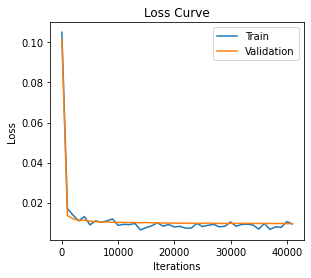

In [ ]:
use_cuda = True

model_noisy2 = CNN_Autoencoder_v2()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model_noisy2.cuda()
#############################################
max_epochs = 100
outputs_noisy2 = train_noisy(model_noisy2, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 1000)

**Visualisation**

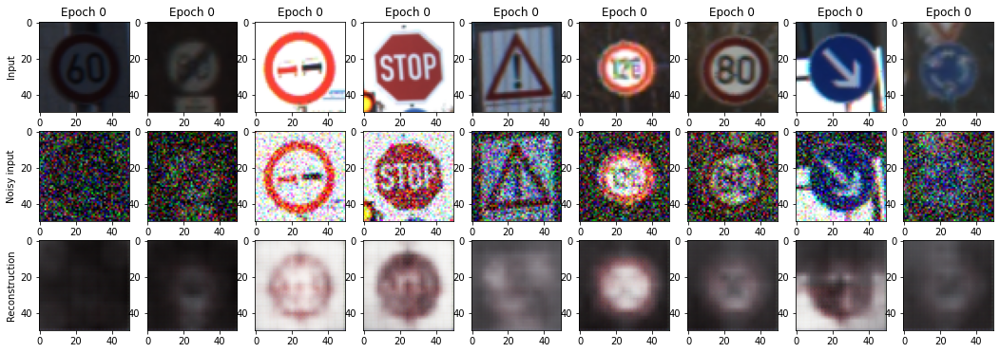

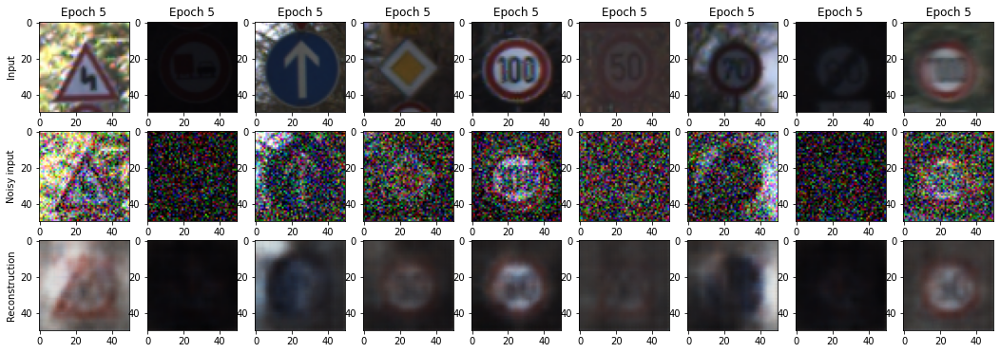

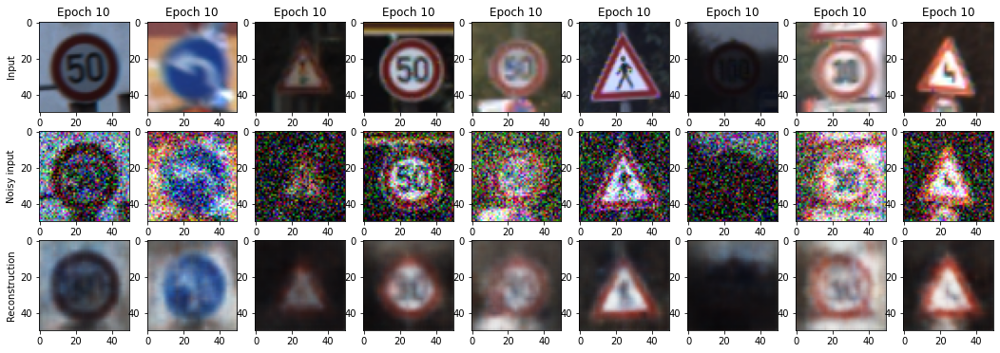

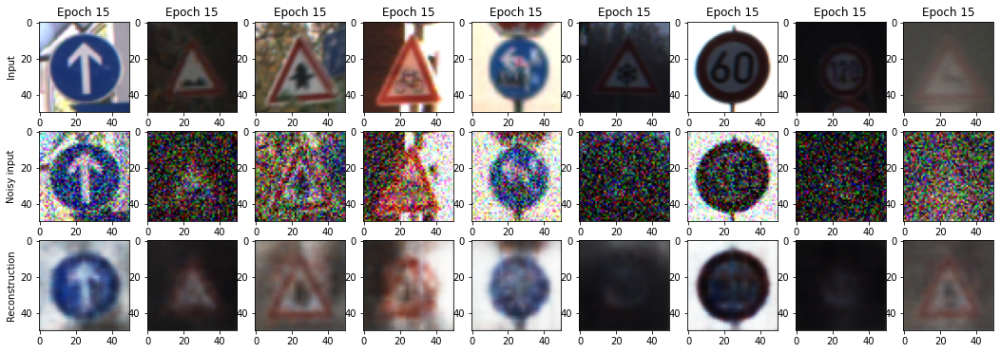

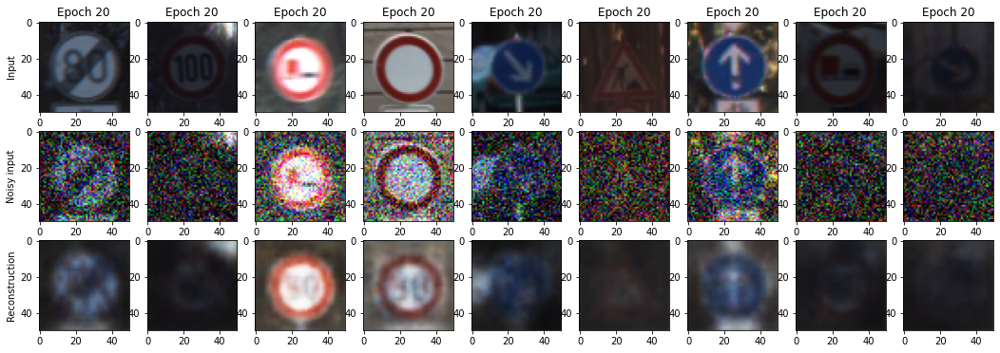

...

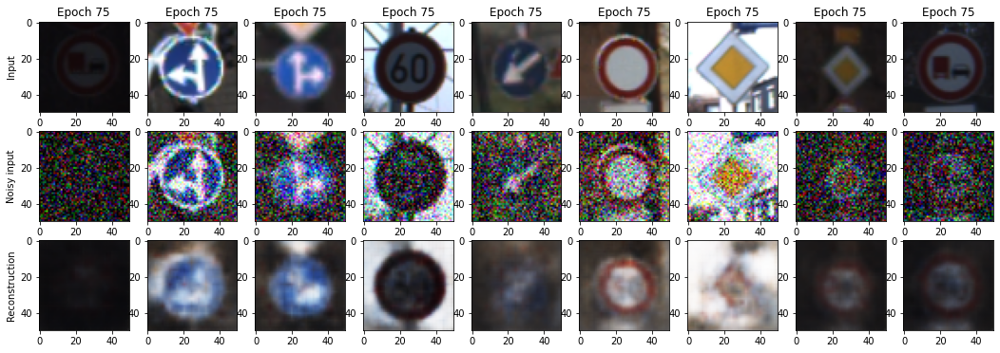

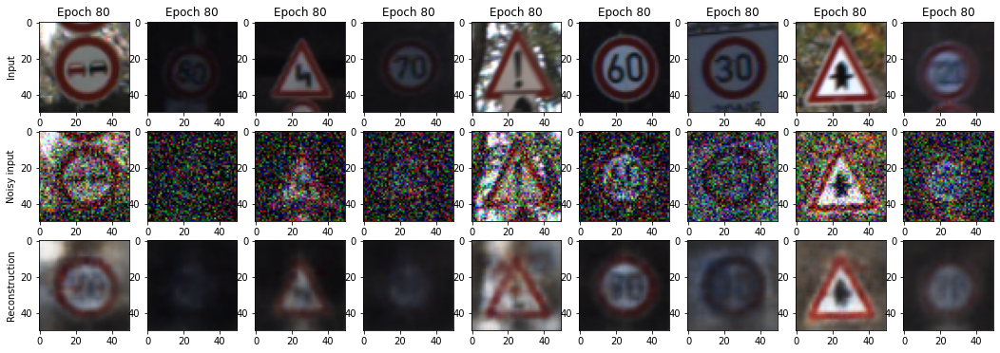

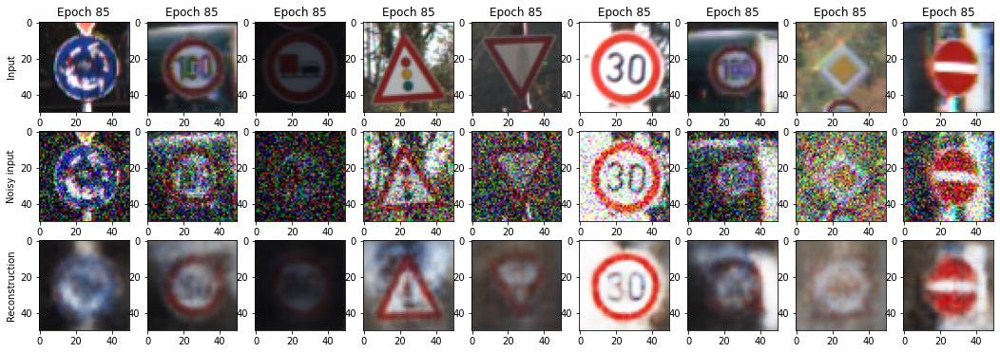

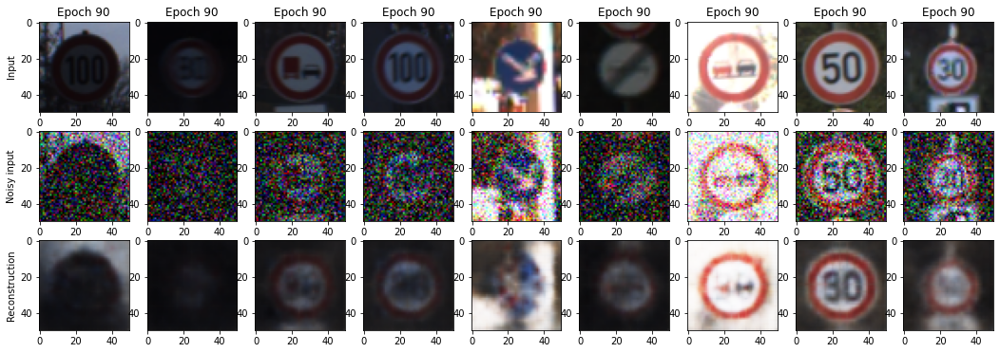

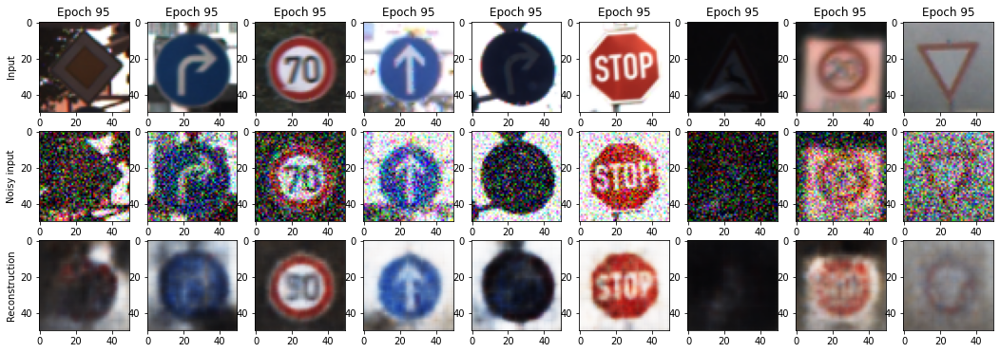

In [ ]:
visualize_training_noisy (outputs_noisy2, plot_every = 5)

### Without GPU

In [ ]:
torch.cuda.is_available()

True

################## EPOCH 0 ##################
Iter:1, Train Loss:0.1094, Val Loss:0.1058
################## EPOCH 1 ##################
################## EPOCH 2 ##################
################## EPOCH 3 ##################
################## EPOCH 4 ##################
################## EPOCH 5 ##################
################## EPOCH 6 ##################
################## EPOCH 7 ##################
################## EPOCH 8 ##################
################## EPOCH 9 ##################
################## EPOCH 10 ##################
################## EPOCH 11 ##################
################## EPOCH 12 ##################
################## EPOCH 13 ##################
################## EPOCH 14 ##################
################## EPOCH 15 ##################
################## EPOCH 16 ##################
################## EPOCH 17 ##################
################## EPOCH 18 ##################
################## EPOCH 19 ##################
################## EPOCH 20

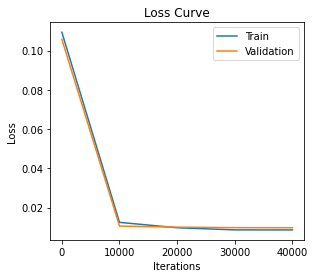

In [ ]:
use_cuda = True

model_noisy_cpu = CNN_Autoencoder_v2()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  model_noisy_cpu.cuda()
#############################################
max_epochs = 100
outputs_noisy_cpu = train_noisy(model_noisy_cpu, ae_train_loader, ae_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 10000)

It seems to work way better with the input noise !

I will continue the optimization of hyperparameters after.

**STEP 1:** Build a autoencoder hable to learn relevant features on our dataset in order to prject it in a small space dimension (embedding space)

**STEP 2:** Visualize the projection and how the speparation of classes is processed in 2D thanks to either PCA or T-SNE algorithm

**STEP 3:** Clustering the dataset with kNN if the separation of the classes is well-done

**SAVE MODEL**

In [ ]:
model_scripted = torch.jit.script(model_noisy_cpu) # Export to TorchScript
model_scripted.save('noisyAE_1.pt') # Save

## STEP 2: Visualize features extraction

Following this tutorial: https://www.kaggle.com/code/rohitgr/autoencoders-tsne

In [ ]:
#Upload
#current_model = torch.jit.load('model_scripted.pt')

current_model = model_noisy_cpu

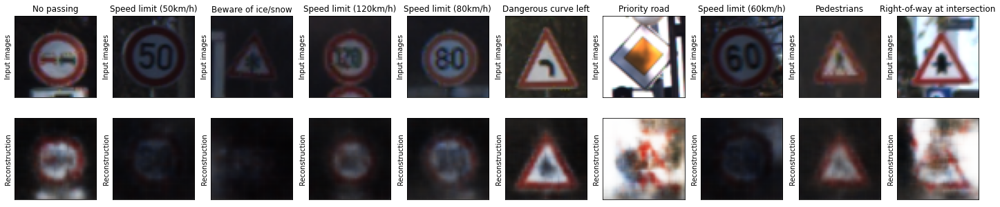

In [ ]:
dataiter = iter(val_loader)

images, labels = dataiter.next()
recons,_ = current_model(images.cuda())
recons = recons.cpu().detach().numpy() # convert images to numpy for display
images = images.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 5))
for idx in np.arange(10):
    ax = fig.add_subplot(2, 10, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(classes[labels[idx].item()])
    ax.set_ylabel('Input images')
    ax = fig.add_subplot(2, 10, idx+1+10, xticks=[], yticks=[])
    plt.imshow(np.transpose(recons[idx], (1, 2, 0)))
    ax.set_ylabel('Reconstruction')

**Get all the embeddings of the train set**

In [ ]:
list_labels = np.empty(0)
list_embenddings = np.empty(0)
list_classes = []

i = 0
with torch.no_grad(): #no need to compute the gradient here it is only inference

  for data in train_loader:

              img, labels = data

              #############################################
              #To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                img = img.cuda()
              #############################################

              _, embendding = current_model(img)

              labels.detach().numpy().shape
              list_labels = np.concatenate([list_labels.astype(int), labels.detach().numpy()])

              if i == 0:
                list_embenddings = embendding.view(-1, 27).cpu().detach().numpy()
                i += 1 
              else:
                list_embenddings = np.concatenate([list_embenddings, embendding.view(-1, 27).cpu().detach().numpy()])


for L in list_labels:
  list_classes.append(classes[L])

list_classes = np.array(list_classes)

In [ ]:
X = list_embenddings.copy()
print(X.shape)
X.reshape(X.shape[0], -1)
print(X.shape)

(26640, 27)
(26640, 27)


In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, TruncatedSVD
#import plotly.express as px
import pandas as pd

SEED = 3
X = list_embenddings.copy()
#Generate different X
X_tsne = TSNE(n_components=2, random_state=SEED).fit_transform(X)
X_pca = PCA(n_components=2, random_state=SEED).fit_transform(X)
X_svd = TruncatedSVD(n_components=2, random_state=SEED).fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [ ]:
################# Create a dataframe to store results
data_emb = np.array([list_classes, list_labels, X_tsne[:,0], X_tsne[:,1], X_pca[:,0], X_pca[:,1], X_svd[:,0], X_svd[:,1]])
df_emb = pd.DataFrame(data_emb.T, columns=['Classes','Labels', 'x_tsne', 'y_tsne', 'x_pca', 'y_pca', 'x_svd', 'y_svd'])

#Save everything
df_emb.to_csv('train_set_projection_noisyAE.csv')  

See plot fiel because can't import plotly

## Try to normalize images

In [ ]:
def normalize_image(img):
  '''
  Normalize the image along each RGB channel
  '''
  max = img.max(axis = 0)
  min = img.min(axis = 0)

  img = (img - min)/(max - min)

  return (img - img.min())/(img.max() - img.min())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: RuntimeWarning:

invalid value encountered in true_divide



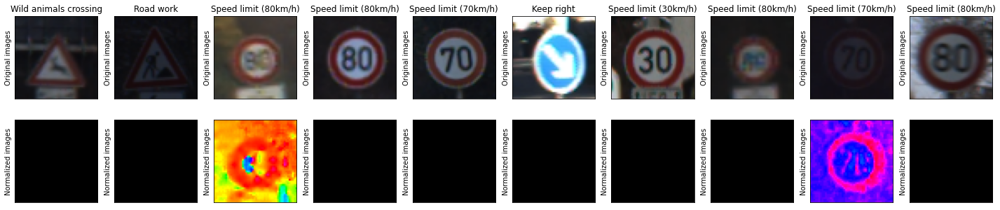

In [ ]:
dataiter = iter(val_loader)

images, labels = dataiter.next()
images = images.detach().numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 5))
for idx in np.arange(10):
    ax = fig.add_subplot(2, 10, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(classes[labels[idx].item()])
    ax.set_ylabel('Original images')
    ax = fig.add_subplot(2, 10, idx+1+10, xticks=[], yticks=[])

    # Normalize image
    image_norm = normalize_image(images[idx])
    plt.imshow(np.transpose(image_norm, (1, 2, 0)))
    ax.set_ylabel('Normalized images')

## AE with AlexNet features

In [ ]:
import torchvision.models
alexnet = torchvision.models.alexnet(pretrained=True)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


  0%|          | 0.00/233M [00:00<?, ?B/s]

Generate images with the write size to match the alexnet input size

In [ ]:
AN_val_loader, AN_test_loader = get_val_test_loader(batch_size=64, img_size=256)
AN_train_loader = get_train_loader(batch_size=64, img_size=256)

  0%|          | 0/88978620 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB_Final_Test_Images.zip to data/gtsrb


  0%|          | 0/99620 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB_Final_Test_GT.zip to data/gtsrb


  0%|          | 0/187490228 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB-Training_fixed.zip to data/gtsrb


In [ ]:
#Debug loader
def get_debug_loader_alexnet(nb_sample=64, batch_size=64, img_size = 256):
  # Rescale images to all be the same size
  data_transform = transforms.Compose([transforms.Resize((img_size,img_size)), 
                                       transforms.ToTensor()])

  # Get paths to data in folder
  debug_data = datasets.GTSRB('data', download=True, split="train",
                        transform=data_transform)
  #print(len(debug_data))
  debug_data = list(debug_data)
  debug_data = debug_data[:nb_sample]
  #print(len(debug_data))

  np.random.seed(1000)
  debug_loader = torch.utils.data.DataLoader(debug_data, batch_size=batch_size,
        num_workers=0, shuffle=True)
  return debug_loader

In [ ]:
AN_debug_loader = get_debug_loader_alexnet(batch_size=64, img_size=256)

NameError: ignored

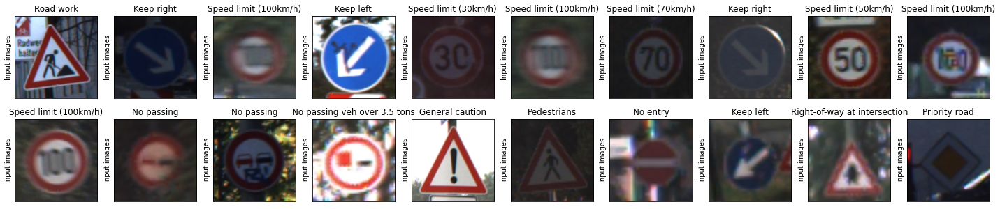

In [ ]:
dataiter_train = iter(AN_train_loader)

images_train, labels_train = dataiter_train.next()
images_train = images_train.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 5))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images_train[idx], (1, 2, 0)))
    ax.set_title(classes[labels_train[idx].item()])
    ax.set_ylabel('Input images')

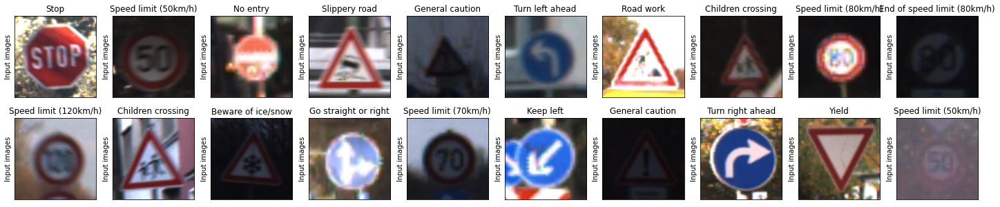

In [ ]:
dataiter_val = iter(AN_val_loader)

images_val, labels_val = dataiter_val.next()
images_val = images_val.numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 5))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images_val[idx], (1, 2, 0)))
    ax.set_title(classes[labels_val[idx].item()])
    ax.set_ylabel('Input images')

### Few test to try the size of the AlexNet

In [ ]:
image = torch.tensor(images_train[idx])
print("Size of image", image.shape)

feat = alexnet.features.cpu()(image)
print("Size of alexnet features:", feat.shape)

Size of image torch.Size([3, 256, 256])
Size of alexnet features: torch.Size([256, 7, 7])


Building the model to reduce the dimension

In [ ]:
image = torch.tensor(images_val[idx])
feature = alexnet.features.cpu()(image)
print("Size of Input", feature.shape)

conv = nn.Conv2d(in_channels=3,
                 out_channels=8,
                 kernel_size=5)

x = image
y = conv(x)


convt = nn.ConvTranspose2d(in_channels=8,
                           out_channels=3,
                           kernel_size=5)
convt(y).shape # should be same as x.shape

print("Shape of x:", x.shape)
print("Shape of y:", y.shape)
print("Shape of x':", convt(y).shape)

Size of Input torch.Size([256, 7, 7])
Shape of x: torch.Size([3, 256, 256])
Shape of y: torch.Size([8, 252, 252])
Shape of x': torch.Size([3, 256, 256])


In [ ]:
x = feat


## Encoder
print("Shape of x:", x.shape)
emb = nn.Conv2d(256, 126, 2, stride=1, padding=0)(x)
print(emb.shape)
emb = nn.Conv2d(126, 64, 2, stride=1, padding=0)(emb)
print(emb.shape)
emb = nn.Conv2d(64, 16, 2, stride=2, padding=1)(emb)
print(emb.shape)
emb = nn.Conv2d(16, 2, 3, stride=2, padding=1)(emb)

print("\nShape of embedding:", emb.shape, end = "\n\n")

## Decoder
y = nn.ConvTranspose2d(2, 16, 3, stride=2, padding=1, output_padding=0)(emb)
print(y.shape)
y = nn.ConvTranspose2d(16, 64, 2, stride=2, padding=1, output_padding=1)(y)
print(y.shape)
y = nn.ConvTranspose2d(64, 126, 2, stride=1, padding=0, output_padding=0)(y)
print(y.shape)
y = nn.ConvTranspose2d(126, 256, 2, stride=1, padding=0, output_padding=0)(y)
print("Shape of x':", y.shape)

Shape of x: torch.Size([256, 7, 7])
torch.Size([126, 6, 6])
torch.Size([64, 5, 5])
torch.Size([16, 3, 3])

Shape of embedding: torch.Size([2, 2, 2])

torch.Size([16, 3, 3])
torch.Size([64, 5, 5])
torch.Size([126, 6, 6])
Shape of x': torch.Size([256, 7, 7])


### Model

In [ ]:
class AlexNet_Autoencoder(nn.Module):
    def __init__(self):
        super(AlexNet_Autoencoder, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
                                     
            nn.Conv2d(256, 64, 2, stride=1, padding=0),                         
            nn.LeakyReLU(),
            nn.Conv2d(64, 16, 3, stride=2, padding=1),                         
            nn.LeakyReLU(),
            nn.Conv2d(16, 8, 2, stride=2, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(8, 2, 3, stride=2, padding=1),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(2, 8, 3, stride=2, padding=1, output_padding=1),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(8, 16, 2, stride=2, padding=1, output_padding=1),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(16, 64, 3, stride=2, padding=1, output_padding=1),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(64, 256, 2, stride=1, padding=0, output_padding=0),
            nn.Sigmoid()
        )

    def forward(self, x):
        # print(x.shape)
        emb = self.encoder(x)
        # print(emb.shape)
        y = self.decoder(emb)
        # print(y.shape)
        return y, emb

### Useful functions for the training

In [ ]:
def get_loss_AnAeCnnNoisy(model, data_loader, criterion, noise):
  loss = 0.0
  total_loss = 0.0
  for imgs, labels in data_loader:

    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
    #############################################
    
    feats = alexnet.features(imgs)

    output,_ = model(feats)
    loss = criterion(output, feats)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader)) #Average loss per batch
  return loss

def train_AnAeNoisy(model, train_loader, val_loader, num_epochs=5, batch_size=64, learning_rate=1e-3, plot_every = 50,val_plot = False):
    torch.manual_seed(42)
    criterion = nn.MSELoss() # mean square error loss
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    iters, train_loss, val_loss = [], [], []
    n = 0

    ##To get reconstructed images at each epoch
    out = []

    noise = 0.25

    for epoch in range(num_epochs):
        print("################## EPOCH {} ##################".format(epoch))
        for data in train_loader:
            img, _ = data

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              img = img.cuda()
            #############################################

            feats = alexnet.features(img)
            # print(img.shape)
            # print(feats.shape)

            output,_ = model(feats)
            loss = criterion(output, feats)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if n % plot_every == 0:
              
              train_loss.append(loss.item())
              iters.append(n+1)

              if val_plot:
                val_loss.append(get_loss_AnAeCnnNoisy(model, val_loader, criterion, noise))
                print('Iter:{}, Train Loss:{:.4f}, Val Loss:{:.4f}'.format(iters[-1], 
                                                                         float(train_loss[-1]),
                                                                         float(val_loss[-1])))
              else:
                print('Iter:{}, Train Loss:{:.4f}'.format(iters[-1],float(train_loss[-1])))
            n = n + 1

        ##To get reconstructed images at each epoch
        #out.append((epoch, img, img_noisy, recon),)


    # plotting
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("Loss Curve")
    plt.plot(iters, train_loss, label="Train")
    plt.plot(iters, val_loss, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend(loc='best')

    print("\n\nFinal Training Loss: {}".format(train_loss[-1]))
    print("Final Validation Loss: {}".format(val_loss[-1]))
    
    ##To get reconstructed images at each epoch
    #return out

# reconstructed images at various parts of training

def visualize_training_noisy (outputs, plot_every = 1):
  """ Show the evolution of the embendding and the reconstruction during the training

      Args:
          outputs: A list of [[input images, embenddings, reconstructions]]
          plot_every: number of epoch to plot images
      
      Returns:
          None 
    """


  for k in range(0, len(outputs), plot_every):
      plt.figure(figsize=(18, 6))
      imgs = outputs[k][1].cpu().detach().numpy()
      emb = outputs[k][2].cpu().detach().numpy()
      recon = outputs[k][3].cpu().detach().numpy()

      for i, item in enumerate(imgs):
          if i >= 9: break
          plt.subplot(3, 9, i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))
          plt.title("Epoch " + str(k))

          if(i == 0):
            plt.ylabel("Input")
          
      for i, item in enumerate(emb):
          if i >= 9: break
          plt.subplot(3, 9, 9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Noisy input")

      for i, item in enumerate(recon):
          if i >= 9: break
          plt.subplot(3, 9, 9+9+i+1)
          plt.imshow((np.transpose(item, (1, 2, 0))* 255).astype(np.uint8))

          if(i == 0):
            plt.ylabel("Reconstruction")

  plt.show()

### Train the model

################## EPOCH 0 ##################
Iter:1, Train Loss:0.3543
Iter:51, Train Loss:0.1887
Iter:101, Train Loss:0.2004
Iter:151, Train Loss:0.1791
Iter:201, Train Loss:0.1680
Iter:251, Train Loss:0.1809
Iter:301, Train Loss:0.1910
Iter:351, Train Loss:0.1836
Iter:401, Train Loss:0.1677
################## EPOCH 1 ##################
Iter:451, Train Loss:0.1761
Iter:501, Train Loss:0.1631
Iter:551, Train Loss:0.1748
Iter:601, Train Loss:0.1800
Iter:651, Train Loss:0.1343
Iter:701, Train Loss:0.1491
Iter:751, Train Loss:0.1654
Iter:801, Train Loss:0.1696
################## EPOCH 2 ##################
Iter:851, Train Loss:0.1544
Iter:901, Train Loss:0.1427
Iter:951, Train Loss:0.1779
Iter:1001, Train Loss:0.1626
Iter:1051, Train Loss:0.1778
Iter:1101, Train Loss:0.1333
Iter:1151, Train Loss:0.1508
Iter:1201, Train Loss:0.1371
Iter:1251, Train Loss:0.1939
################## EPOCH 3 ##################
Iter:1301, Train Loss:0.1387
Iter:1351, Train Loss:0.1471
Iter:1401, Train Loss:0.156

ValueError: ignored

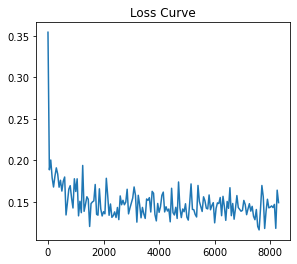

In [ ]:
use_cuda = True

AlexNet_model = AlexNet_Autoencoder()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  AlexNet_model.cuda()
  alexnet.cuda()
#############################################
max_epochs = 20
outputs = train_AnAeNoisy(AlexNet_model, AN_train_loader, AN_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 50, val_plot = False)

In [ ]:
list_labels = np.empty(0)
list_embenddings = np.empty(0)
list_classes = []

i = 0
with torch.no_grad(): #no need to compute the gradient here it is only inference

  for data in AN_train_loader:

              img, labels = data

              #############################################
              #To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                img = img.cuda()
              #############################################

              _, embendding = AlexNet_model(alexnet.features(img))

              labels.detach().numpy().shape
              list_labels = np.concatenate([list_labels.astype(int), labels.detach().numpy()])

              if i == 0:
                list_embenddings = embendding.view(-1, 2).cpu().detach().numpy()
                i += 1 
              else:
                list_embenddings = np.concatenate([list_embenddings, embendding.view(-1, 2).cpu().detach().numpy()])


for L in list_labels:
  list_classes.append(classes[L])

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, TruncatedSVD
#import plotly.express as px
import pandas as pd

SEED = 3
X = list_embenddings.copy()
#Generate different X
X_tsne = TSNE(n_components=2, random_state=SEED).fit_transform(X)
X_pca = PCA(n_components=2, random_state=SEED).fit_transform(X)
X_svd = TruncatedSVD(n_components=1, random_state=SEED).fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


ValueError: ignored

In [ ]:
X_svd = TruncatedSVD(n_components=1, random_state=SEED).fit_transform(X)

In [ ]:
################# Create a dataframe to store results
data_emb = np.array([list_classes, list_labels, X_tsne[:,0], X_tsne[:,1], X_pca[:,0], X_pca[:,1], X_svd[:,0]])#, X_svd[:,1]])
df_emb = pd.DataFrame(data_emb.T, columns=['Classes','Labels', 'x_tsne', 'y_tsne', 'x_pca', 'y_pca','x_svd'])# 'y_svd'])

#Save everything
df_emb.to_csv('train_set_projection_AlexNet.csv')  

In [ ]:
#Save model
model_scripted = torch.jit.script(AlexNet_model) # Export to TorchScript
model_scripted.save('AlexNetModel1.pt') # Save

### With a higher embedding space 

In [ ]:
class AlexNet_Autoencoder_bigger(nn.Module):
    def __init__(self):
        super(AlexNet_Autoencoder_bigger, self).__init__()
        self.encoder = nn.Sequential( # like the Composition layer you built
                                     
            nn.Conv2d(256, 126, 2, stride=1, padding=0),                         
            nn.LeakyReLU(),
            nn.Conv2d(126, 64, 2, stride=1, padding=0),                         
            nn.LeakyReLU(),
            nn.Conv2d(64, 16, 2, stride=2, padding=1),
            nn.LeakyReLU(),
            nn.Conv2d(16, 2, 3, stride=2, padding=1),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(2, 16, 3, stride=2, padding=1, output_padding=0),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(16, 64, 2, stride=2, padding=1, output_padding=1),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(64, 128, 2, stride=1, padding=0, output_padding=0),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(128, 256, 2, stride=1, padding=0, output_padding=0),
            nn.Sigmoid()
        )

    def forward(self, x):
        # print(x.shape)
        emb = self.encoder(x)
        # print(emb.shape)
        y = self.decoder(emb)
        # print(y.shape)
        return y, emb

################## EPOCH 0 ##################
Iter:1, Train Loss:0.3542, Val Loss:0.3629
################## EPOCH 1 ##################
################## EPOCH 2 ##################
################## EPOCH 3 ##################
################## EPOCH 4 ##################
################## EPOCH 5 ##################
################## EPOCH 6 ##################
################## EPOCH 7 ##################
################## EPOCH 8 ##################
################## EPOCH 9 ##################
################## EPOCH 10 ##################
################## EPOCH 11 ##################
Iter:5001, Train Loss:0.1348, Val Loss:0.1310
################## EPOCH 12 ##################
################## EPOCH 13 ##################
################## EPOCH 14 ##################
################## EPOCH 15 ##################
################## EPOCH 16 ##################
################## EPOCH 17 ##################
################## EPOCH 18 ##################
################## EPOCH 19 

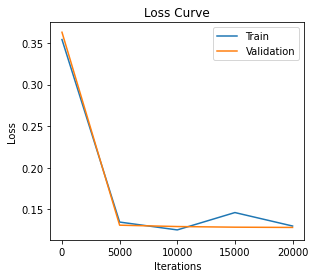

In [ ]:
use_cuda = True

AlexNet_model_2 = AlexNet_Autoencoder_bigger()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  AlexNet_model_2.cuda()
  alexnet.cuda()
#############################################
max_epochs = 50
outputs = train_AnAeNoisy(AlexNet_model_2, AN_train_loader, AN_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 5000, val_plot = True)

In [ ]:
#Save model
model_scripted = torch.jit.script(AlexNet_model_2) # Export to TorchScript
model_scripted.save('AlexNetModel2.pt') # Save

In [ ]:
list_labels = np.empty(0)
list_embenddings = np.empty(0)
list_classes = []

i = 0
with torch.no_grad(): #no need to compute the gradient here it is only inference

  for data in AN_train_loader:

              img, labels = data

              #############################################
              #To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                img = img.cuda()
              #############################################

              _, embendding = AlexNet_model_2(alexnet.features(img))

              labels.detach().numpy().shape
              list_labels = np.concatenate([list_labels.astype(int), labels.detach().numpy()])

              if i == 0:
                list_embenddings = embendding.view(-1, 8).cpu().detach().numpy()
                i += 1 
              else:
                list_embenddings = np.concatenate([list_embenddings, embendding.view(-1, 8).cpu().detach().numpy()])


for L in list_labels:
  list_classes.append(classes[L])

In [ ]:
list_embenddings.shape

(26640, 8)

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, TruncatedSVD
#import plotly.express as px
import pandas as pd

SEED = 3
X = list_embenddings.copy()
#Generate different X
#X_tsne = TSNE(n_components=2, random_state=SEED).fit_transform(X)
X_pca = PCA(n_components=2, random_state=SEED).fit_transform(X)
X_svd = TruncatedSVD(n_components=2, random_state=SEED).fit_transform(X)



In [ ]:
################# Create a dataframe to store results
data_emb = np.array([list_classes, list_labels, X_pca[:,0], X_pca[:,1], X_svd[:,0], X_svd[:,1]])
df_emb = pd.DataFrame(data_emb.T, columns=['Classes','Labels', 'x_pca', 'y_pca','x_svd','y_svd'])

#Save everything
df_emb.to_csv('train_set_projection_AlexNet2.csv')  

## Use the AE with a classifier

### Import data and models

In [ ]:
AN_val_loader, AN_test_loader = get_val_test_loader(batch_size=64, img_size=256)
AN_train_loader = get_train_loader(batch_size=64, img_size=256)

#Load Alexnet
import torchvision.models
alexnet = torchvision.models.alexnet(pretrained=True)

#Load the trained AE model 
AE_model = torch.load('/content/AlexNetModel2.pt')
AE_model.eval()

  0%|          | 0/88978620 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB_Final_Test_Images.zip to data/gtsrb


  0%|          | 0/99620 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB_Final_Test_GT.zip to data/gtsrb


  0%|          | 0/187490228 [00:00<?, ?it/s]

Extracting data/gtsrb/GTSRB-Training_fixed.zip to data/gtsrb


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


  0%|          | 0.00/233M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/torch/serialization.py:709: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  " silence this warning)", UserWarning)


RecursiveScriptModule(
  original_name=AlexNet_Autoencoder_bigger
  (encoder): RecursiveScriptModule(
    original_name=Sequential
    (0): RecursiveScriptModule(original_name=Conv2d)
    (1): RecursiveScriptModule(original_name=LeakyReLU)
    (2): RecursiveScriptModule(original_name=Conv2d)
    (3): RecursiveScriptModule(original_name=LeakyReLU)
    (4): RecursiveScriptModule(original_name=Conv2d)
    (5): RecursiveScriptModule(original_name=LeakyReLU)
    (6): RecursiveScriptModule(original_name=Conv2d)
  )
  (decoder): RecursiveScriptModule(
    original_name=Sequential
    (0): RecursiveScriptModule(original_name=ConvTranspose2d)
    (1): RecursiveScriptModule(original_name=LeakyReLU)
    (2): RecursiveScriptModule(original_name=ConvTranspose2d)
    (3): RecursiveScriptModule(original_name=LeakyReLU)
    (4): RecursiveScriptModule(original_name=ConvTranspose2d)
    (5): RecursiveScriptModule(original_name=LeakyReLU)
    (6): RecursiveScriptModule(original_name=ConvTranspose2d)
    

### Few tests of dimension

In [ ]:
use_cuda = True

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  AE_model.cuda()
  alexnet.cuda()
#############################################

In [ ]:
x = torch.rand(3, 256, 256)

with torch.no_grad():
  print('x:', x.size())
  input_ae = alexnet.features(x.cuda())
  print('input autoencoder:', input_ae.size())
  output_ae = AE_model.encoder(input_ae)
  print('ouput autoencoder:', output_ae.size())

x: torch.Size([3, 256, 256])
input autoencoder: torch.Size([256, 7, 7])
ouput autoencoder: torch.Size([2, 2, 2])


### Our classifier

In [ ]:
class AE_Linear_Classifier(nn.Module):
  def __init__(self):
    super(AE_Linear_Classifier, self).__init__()
    self.fc1 = nn.Linear(8, 16)
    self.fc2 = nn.Linear(16, 32)
    self.fc3 = nn.Linear(32, 43)
        
  def forward(self, x):
    x = x.view(-1, 8) # Flatten the image
    x = F.leaky_relu(self.fc1(x))
    x = F.leaky_relu(self.fc2(x))
    x = self.fc3(x)
    x = x.squeeze(1) # Flatten to [batch_size]
    return x

### Train and Loss function for the classifier

In [ ]:
def get_accuracy_AEClassifier(model, data_loader):
    correct = 0
    total = 0
    for imgs, labels in data_loader:
        #############################################
        #To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
        #############################################

        with torch.no_grad():
          input = AE_model.encoder(alexnet.features(imgs))
        output = model(input)
        pred = output.max(1, keepdim=True)[1] # get the index of the max logit
        correct += pred.eq(labels.view_as(pred)).sum().item()
        total += imgs.shape[0]
    return correct / total


def get_loss_AEClassifier(model, data_loader, criterion):
  loss = 0.0
  total_loss = 0.0
  for imgs, labels in data_loader:

    #############################################
    #To Enable GPU Usage
    if use_cuda and torch.cuda.is_available():
      imgs = imgs.cuda()
      labels = labels.cuda()
    #############################################
    with torch.no_grad():
      input = AE_model.encoder(alexnet.features(imgs))
    
    output = model(input)

    loss = criterion(output, labels)
    total_loss += loss.item()

  loss = float(total_loss) / (len(data_loader)) #Average loss per batch
  return loss

def train_AEClassifier(model, train_loader, val_loader, num_epochs=5, batch_size=64, learning_rate=1e-3, plot_every = 50,val_plot = False):
    torch.manual_seed(42)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(),
                                 lr=learning_rate, 
                                 weight_decay=1e-5)
    iters, train_loss, val_loss, train_acc, val_acc = [], [], [], [], []
    n = 0

    ##To get reconstructed images at each epoch
    out = []

    noise = 0.25

    for epoch in range(num_epochs):
        mini_b=0
        mini_batch_correct = 0
        Mini_batch_total = 0
        print("################## EPOCH {} ##################".format(epoch))
        for data in train_loader:
            img, label = data

            #############################################
            #To Enable GPU Usage
            if use_cuda and torch.cuda.is_available():
              img = img.cuda()
              label = label.cuda()
            #############################################

            
            with torch.no_grad():
              input = AE_model.encoder(alexnet.features(img)) #No need of a grad

            output = model(input)

            loss = criterion(output, label)

            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            if n % plot_every == 0:
              
              train_loss.append(loss.item()) #loss on the current batch
              iters.append(n+1)

              ##### Mini_batch Accuracy ##### We don't compute accuracy on the whole training set in every iteration!
              pred = output.max(1, keepdim=True)[1]
              mini_batch_correct = pred.eq(label.view_as(pred)).sum().item()
              Mini_batch_total = img.shape[0]
              train_acc.append((mini_batch_correct / Mini_batch_total))

              if val_plot:
                val_loss.append(get_loss_AEClassifier(model, val_loader, criterion))
                val_acc.append(get_accuracy_AEClassifier(model, val_loader))
                
                print('Iter:{}, Train Loss:{:.4f}, Train Acc:{:.4f}, Val Loss:{:.4f}, Val Acc:{:.4f}'.format(iters[-1], 
                                                                         float(train_loss[-1]),
                                                                         float(train_acc[-1]), 
                                                                         float(val_loss[-1]),
                                                                         float(val_acc[-1])))
              else:
                print('Iter:{}, Train Loss:{:.4f}'.format(iters[-1],float(train_loss[-1])))
            n = n + 1

        ##To get reconstructed images at each epoch
        #out.append((epoch, img, img_noisy, recon),)


    # plotting
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.title("Loss Curve")
    plt.plot(iters, train_loss, label="Train")
    plt.plot(iters, val_loss, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend(loc='best')
    
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,2)
    plt.title("Accuracy Curve")
    plt.plot(iters, train_acc, label="Train")
    plt.plot(iters, val_acc, label="Validation")
    plt.xlabel("Iterations")
    plt.ylabel("Accuracy")
    plt.legend(loc='best')

    print("\n\nFinal Training Loss: {}".format(train_loss[-1]))
    print("Final Training Accuracy: {}".format(train_acc[-1]))
    print("Final Validation Loss: {}".format(val_loss[-1]))
    print("Final Validation Accuracy: {}".format(val_acc[-1]))

### Train the first classifier

In [ ]:
use_cuda = True

classifier2 = AE_Linear_Classifier()

#############################################
#To Enable GPU Usage
if use_cuda and torch.cuda.is_available():
  classifier2.cuda()
  alexnet.cuda()
  AE_model.cuda()
#############################################
max_epochs = 50
train_AEClassifier(classifier2, AN_train_loader, AN_val_loader, num_epochs=max_epochs, batch_size=64, learning_rate=1e-3, plot_every = 500, val_plot = True)

################## EPOCH 0 ##################
Iter:1, Train Loss:15.3936, Train Acc:0.0000, Val Loss:14.4360, Val Acc:0.0299
################## EPOCH 1 ##################
Iter:501, Train Loss:1.9201, Train Acc:0.3594, Val Loss:2.1455, Val Acc:0.3584
################## EPOCH 2 ##################
Iter:1001, Train Loss:1.8849, Train Acc:0.4375, Val Loss:2.0187, Val Acc:0.3841
################## EPOCH 3 ##################
Iter:1501, Train Loss:1.8429, Train Acc:0.3906, Val Loss:2.0060, Val Acc:0.3930
################## EPOCH 4 ##################
Iter:2001, Train Loss:1.6385, Train Acc:0.5312, Val Loss:1.9948, Val Acc:0.3927
################## EPOCH 5 ##################
Iter:2501, Train Loss:1.5776, Train Acc:0.5156, Val Loss:1.9830, Val Acc:0.4088
################## EPOCH 6 ##################
################## EPOCH 7 ##################
Iter:3001, Train Loss:1.6866, Train Acc:0.5000, Val Loss:2.0000, Val Acc:0.4124
################## EPOCH 8 ##################
Iter:3501, Train Loss:1.6570

KeyboardInterrupt: ignored

In [ ]:
#Save model
model_scripted = torch.jit.script(classifier2) # Export to TorchScript
model_scripted.save('Classifier2.pt') # Save

### Save the results

In [ ]:
classifier2 = torch.load('/content/Classifier2.pt').cpu()
classifier2.eval()

/usr/local/lib/python3.7/dist-packages/torch/serialization.py:709: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  " silence this warning)", UserWarning)


RecursiveScriptModule(
  original_name=AE_Linear_Classifier
  (fc1): RecursiveScriptModule(original_name=Linear)
  (fc2): RecursiveScriptModule(original_name=Linear)
  (fc3): RecursiveScriptModule(original_name=Linear)
)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  


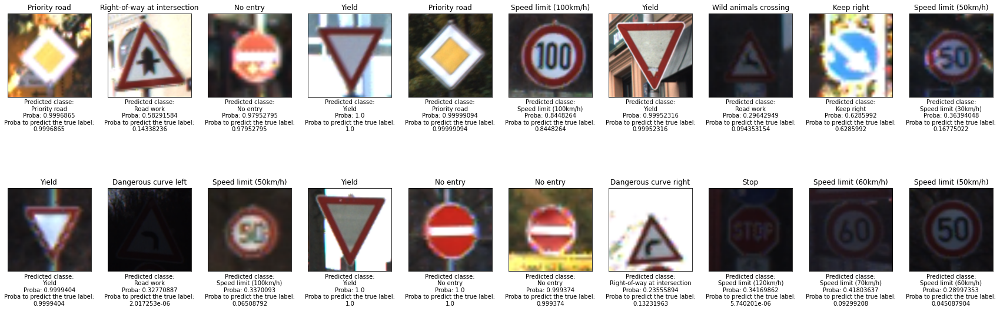

In [ ]:
############## TEST PROBA ON THE TRUE LABEL
dataiter = iter(AN_val_loader)

images, labels = dataiter.next()


with torch.no_grad():
  pred = F.softmax((classifier2.cuda())((AE_model.encoder(alexnet.features(images.cuda())))))

#Compute the pred
predicted_classes = pred.max(1, keepdim=True)[1].cpu().detach().numpy()
pred = pred.cpu().detach().numpy()

images = images.detach().numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(30, 10))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 10, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(classes[labels[idx].item()])
    ax.set_xlabel('Predicted classe:\n' + classes[predicted_classes[idx][0]] + '\nProba: '+ str(pred[idx][predicted_classes[idx][0]]) + '\nProba to predict the true label:\n' + str(pred[idx][labels[idx].item()]))

In [ ]:
list_labels = np.empty(0)
list_embenddings = np.empty(0)
list_true_proba = np.empty(0)
list_max_proba = np.empty(0)

list_dataset = np.empty(0) #0 : 'Train', 2 : 'Test', 1 : 'Validation'
list_classes = [] 
list_predicted_labels = np.empty(0)
list_predicted_classes = []

i = 0
with torch.no_grad(): #no need to compute the gradient here it is only inference

  for data in AN_train_loader:

              img, labels = data

              #############################################
              #To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                img = img.cuda()
              #############################################

              with torch.no_grad():
                _, embendding = AE_model(alexnet.features(img.cuda()))
                pred = F.softmax(classifier2(embendding))

              #Compute the pred
              predicted_classes = pred.max(1, keepdim=True)[1].cpu().detach().numpy()
              pred = pred.cpu().detach().numpy()             
              
              #MAX PROBA
              list_max_proba = np.concatenate([list_max_proba, pred.max(axis = 1)])

              #TRUE LABEL
              list_true_proba = np.concatenate([list_true_proba, np.take_along_axis(pred, labels.detach().numpy().reshape(-1,1), axis=1).reshape(-1)])

              #TRUE LABEL
              list_labels = np.concatenate([list_labels.astype(int), labels.detach().numpy()])

              #PREDICTED LABEL
              list_predicted_labels = np.concatenate([list_predicted_labels.astype(int), predicted_classes.reshape(-1)])
              
              #Origin of the sample
              list_dataset = np.concatenate([list_dataset, np.array(['Train'] * pred.shape[0])])

              if i == 0:
                list_embenddings = embendding.view(-1, 8).cpu().detach().numpy()
                i += 1 
              else:
                list_embenddings = np.concatenate([list_embenddings, embendding.view(-1, 8).cpu().detach().numpy()])

  ##### Save this part for the pca
  train_list_embenddings = list_embenddings

  #### Same thing on the val loader
  for data in AN_val_loader:

              img, labels = data

              #############################################
              #To Enable GPU Usage
              if use_cuda and torch.cuda.is_available():
                img = img.cuda()
              #############################################

              with torch.no_grad():
                _, embendding = AE_model(alexnet.features(img.cuda()))
                pred = F.softmax(classifier2(embendding))

              #Compute the pred
              predicted_classes = pred.max(1, keepdim=True)[1].cpu().detach().numpy()
              pred = pred.cpu().detach().numpy()             
              
              #MAX PROBA
              list_max_proba = np.concatenate([list_max_proba, pred.max(axis = 1)])

              #TRUE LABEL
              list_true_proba = np.concatenate([list_true_proba, np.take_along_axis(pred, labels.detach().numpy().reshape(-1,1), axis=1).reshape(-1)])

              #TRUE LABEL
              list_labels = np.concatenate([list_labels.astype(int), labels.detach().numpy()])

              #PREDICTED LABEL
              list_predicted_labels = np.concatenate([list_predicted_labels.astype(int), predicted_classes.reshape(-1)])
              
              #Origin of the sample
              list_dataset = np.concatenate([list_dataset, np.array(['Validation'] * pred.shape[0])])

              list_embenddings = np.concatenate([list_embenddings, embendding.view(-1, 8).cpu().detach().numpy()])



for L in list_labels:
  list_classes.append(classes[L])

for L in list_predicted_labels:
  list_predicted_classes.append(classes[L])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:69: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.


In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, TruncatedSVD
#import plotly.express as px
import pandas as pd

SEED = 3
X = train_list_embenddings
#Generate different X
#X_tsne = TSNE(n_components=2, random_state=SEED).fit_transform(X)
pca = PCA(n_components=2, random_state=SEED).fit(X)
svd = TruncatedSVD(n_components=2, random_state=SEED).fit(X)

In [ ]:
X = list_embenddings.copy()

X_pca = pca.transform(X)
X_svd = svd.transform(X)

In [ ]:
list_is_correct = np.array(list_classes) == np.array(list_predicted_classes)

In [ ]:
################# Create a dataframe to store results
data_classifier = np.array([np.array(list_classes), np.array(list_predicted_classes), list_is_correct, list_true_proba, list_max_proba, list_dataset, X_pca[:,0], X_pca[:,1], X_svd[:,0], X_svd[:,1]])
df_classifier = pd.DataFrame(data_classifier.T, columns=['Classes','Labels', 'Is Correct', 'Proba of true label', 'Max proba', 'Origin', 'x_pca', 'y_pca','x_svd','y_svd'])

#Save everything
df_classifier.to_csv('classification_on_val_and_train2.csv')  

## Create subclasses

In [ ]:
# Label Overview
sub_classes = { 0:'Speed limit',
            1:'Speed limit', 
            2:'Speed limit', 
            3:'Speed limit', 
            4:'Speed limit', 
            5:'Speed limit', 
            6:'End of speed limit', 
            7:'Speed limit', 
            8:'Speed limit', 
            9:'Interdiction', 
            10:'Interdiction', 
            11:'Warning', 
            12:'Priority road', 
            13:'Yield', 
            14:'Stop', 
            15:'Interdiction', 
            16:'Interdiction', 
            17:'No entry', 
            18:'Warning', 
            19:'Warning', 
            20:'Warning', 
            21:'Warning', 
            22:'Warning', 
            23:'Warning', 
            24:'Warning', 
            25:'Warning', 
            26:'Warning', 
            27:'Pedestrians', 
            28:'Warning', 
            29:'Warning', 
            30:'Warning',
            31:'Warning', 
            32:'End speed + passing limits', 
            33:'Obligation', 
            34:'Obligation', 
            35:'Obligation', 
            36:'Obligation', 
            37:'Obligation', 
            38:'Obligation', 
            39:'Obligation', 
            40:'Obligation', 
            41:'End of no passing', 
            42:'End no passing veh > 3.5 tons' }

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  


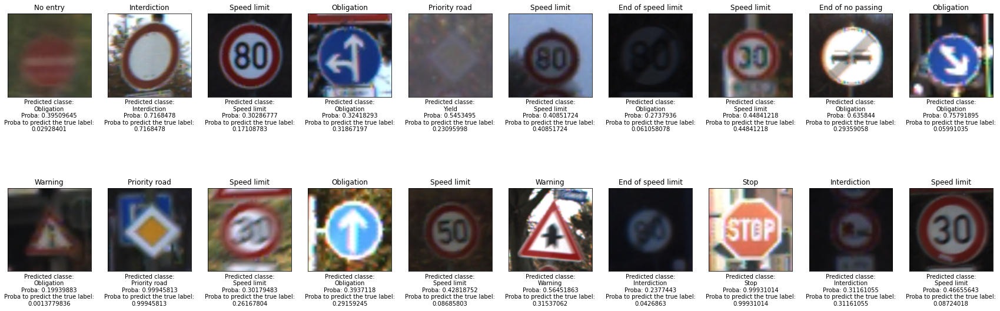

In [ ]:
############## TEST SUB CLASSES
dataiter = iter(AN_val_loader)

images, labels = dataiter.next()


with torch.no_grad():
  pred = F.softmax((classifier2.cuda())((AE_model.encoder(alexnet.features(images.cuda())))))

#Compute the pred
predicted_classes = pred.max(1, keepdim=True)[1].cpu().detach().numpy()
pred = pred.cpu().detach().numpy()

images = images.detach().numpy() # convert images to numpy for display

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(30, 10))
for idx in np.arange(20):
    ax = fig.add_subplot(2, 10, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(sub_classes[labels[idx].item()])
    ax.set_xlabel('Predicted classe:\n' + sub_classes[predicted_classes[idx][0]] + '\nProba: '+ str(pred[idx][predicted_classes[idx][0]]) + '\nProba to predict the true label:\n' + str(pred[idx][labels[idx].item()]))

In [ ]:
list_subclasses = []
list_predicted_subclasses = []


for L in list_labels:
  list_subclasses.append(sub_classes[L])

for L in list_predicted_labels:
  list_predicted_subclasses.append(sub_classes[L])

list_is_correct_subclasses = np.array(list_subclasses) == np.array(list_predicted_subclasses)

In [ ]:
################# Create a dataframe to store results
data_classifier = np.array([np.array(list_classes), np.array(list_predicted_classes),
                            list_subclasses, list_predicted_subclasses, list_is_correct_subclasses,
                            list_is_correct, list_true_proba, list_max_proba, list_dataset, 
                            X_pca[:,0], X_pca[:,1], X_svd[:,0], X_svd[:,1]])
df_classifier = pd.DataFrame(data_classifier.T, columns=['Classes','Predicted_classes','Subclasses', 'Predicted Sublasses', 'Is Correct Subclasses',
                                                         'Is Correct', 'Proba of true label', 'Max proba', 'Origin', 
                                                         'x_pca', 'y_pca','x_svd','y_svd'])

#Save everything
df_classifier.to_csv('classification_on_val_and_train_2bis.csv')  